# Описание проекта
В рамках проекта проведён анализ данных о заведениях общественного питания в Москве на основе информации сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. 

Целью исследования являлось предоставить для инвесторов из фонда «Shut Up and Take My Money» информацию о потенциале открытия в Москве нового заведения общественного питания (кофейни в стиле сериала Друзья) на основе уже имеющейся информации. 

Подготовлено исследование рынка, найдены интересные особенности и полученные результаты оформлены в виде презентации, которая в будущем поможет в выборе подходящего инвесторам места, типа и ценовой политики заведения для открытия.

# Импорт библиотек

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)

import numpy as np

import re

import matplotlib.pyplot as plt

import plotly.express as px
from plotly import graph_objects as go

from folium import Marker, Map, Choropleth
from folium.plugins import MarkerCluster
state_geo = '/datasets/admin_level_geomap.geojson'
moscow_lat, moscow_lng = 55.751244, 37.618423

## Импорт данных

In [2]:
data = pd.read_csv('/datasets/moscow_places.csv')

In [3]:
display(data)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0


Датасет содержит 8406 записей об объектах общественного питания, характеризуемых данными в 14 столбцах, включая:

__name__ — название заведения;

__address__ — адрес заведения;

__category__ — категория заведения, например «кафе», «пиццерия» или «кофейня»;

__hours__ — информация о днях и часах работы;

__lat__ и __lng__ — широта и долгота географической точки, в которой находится заведение;

__rating__ — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);

__price__ — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;

__avg_bill__ — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
  
* «Средний счёт: 1000–1500 ₽»
* «Цена чашки капучино: 130–220 ₽»
* «Цена бокала пива: 400–600 ₽»

__middle_avg_bill__ — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
  
* Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
* Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
* Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.

__middle_coffee_cup__ — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
  
* Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
* Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
* Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.

__chain__ — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым :
* 0 — заведение не является сетевым
* 1 — заведение является сетевым

__district__ — административный район, в котором находится заведение, например Центральный административный округ;
seats — количество посадочных мест.

## Предобработка данных

### Типы и значения

Выясним, не содержаться ли в датасете данные в неудобных для дальнейшего анализа типах и аномальных значений в столбцах, содержащих численные значения:

In [4]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB
None


In [5]:
display(data.describe())

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


Географическое положение объектов __lat__ и __lng__ в датасете примерно соответствует положению географического центра Москвы 55.4521 с.ш. и 37.3704 в.д.

Максимальная цена чашки кофе в 1568 руб в столбце __middle_coffee_cup__ может много говорить о уровне заведения в целом.

Заведение с 1288 в столбце количества посадочных мест __seats__ также вызывает подозрение. 

Среднее значение в столбце __chain__ равное 0.38 говорит о том, что в Москве преобладают несетевые заведения общественного питания.

### Аномальные значения

#### Средняя цена чашки кофе

In [6]:
print('Количество заведений с указанной информацией цены за чашку капучино -',
      data[data['middle_coffee_cup'] >= 0]['name'].count())

Количество заведений с указанной информацией цены за чашку капучино - 535


In [7]:
data[data['middle_coffee_cup'] >= 1000]['name'].count()

1

In [8]:
display(data.query('middle_coffee_cup > 1000'))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2859,Шоколадница,кофейня,"Москва, Большая Семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,1,48.0


Всего в столбце __middle_coffee_cup__ есть только 535 записи. При этом для 1 объекта цена чашки кофе выше 1000 руб. Учитывая задание с потенциальным открытием новой кофейни, отнесёмся к этой аномали аккуратно. Исправим и не будем удалять запись о кофейне в целом. 

По всей видимости, кто-то ошибся в заполнении данных для объекта:

_Цена чашки капучино:230–2907_

Отсюда и высокая средняя цена. Среднее значение в диапазоне 230-290 - это 260 руб. Перепишем значение в ячейке.

In [9]:
data.loc[(data['middle_coffee_cup'] == 1568),'middle_coffee_cup'] = 230

#### Средний чек

In [10]:
data[data['middle_avg_bill'] >= 0]['name'].count()

3149

In [11]:
display(data.query('middle_avg_bill > 5000'))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
730,Чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,0,49.0
2795,Крошка Картошка,быстрое питание,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"ежедневно, 10:00–22:00",55.811160,37.799823,4.0,высокие,Средний счёт:1000–10000 ₽,5500.0,NaN,1,NaN
3038,Беллини,ресторан,"Москва, Рублёвское шоссе, 28",Западный административный округ,"ежедневно, 12:00–00:00",55.747632,37.425631,4.3,высокие,Средний счёт:5000–5500 ₽,5250.0,NaN,0,150.0
3396,Марио,ресторан,"Москва, улица Климашкина, 17",Центральный административный округ,"ежедневно, 12:00–00:00",55.767792,37.568453,4.5,высокие,Средний счёт:7000 ₽,7000.0,NaN,0,100.0
3487,800°с Contemporary Steak,ресторан,"Москва, Большой Патриарший переулок, 6, стр. 1",Центральный административный округ,"ежедневно, 09:00–23:30",55.762708,37.592138,4.7,высокие,Средний счёт:6000–8000 ₽,7000.0,NaN,0,75.0
3518,Чайка,ресторан,"Москва, Краснопресненская набережная, 12А",Центральный административный округ,"ежедневно, 12:00–00:00",55.752857,37.556365,4.8,высокие,Средний счёт:5000–8000 ₽,6500.0,NaN,1,250.0
3603,Lucky Izakaya Bar,"бар,паб","Москва, Калашный переулок, 9",Центральный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.757313,37.599581,4.8,высокие,Средний счёт:5500 ₽,5500.0,NaN,0,NaN
3882,White Rabbit,ресторан,"Москва, Смоленская площадь, 3",Центральный административный округ,"ежедневно, 12:00–00:00",55.747608,37.581248,4.9,высокие,Средний счёт:7000–7500 ₽,7250.0,NaN,0,150.0
3910,Кантинетта Антинори,ресторан,"Москва, Денежный переулок, 20",Центральный административный округ,"ежедневно, 12:00–00:00",55.745383,37.586595,4.7,высокие,Средний счёт:6000 ₽,6000.0,NaN,0,80.0
5481,Гости,ресторан,"Москва, шоссе Энтузиастов, 52",Восточный административный округ,"пн,вс 18:00–22:30",55.759088,37.760570,4.1,высокие,Средний счёт:5000–15000 ₽,10000.0,NaN,0,NaN


Среди 3149 заведений, для которых указан средний чек в столбце __middle_avg_bill__, выделяются значениями выше 5000 руб всего несколько заведений. Среди них - получивший недавно Мишленовскую Звезду ресторан _White Rabbit_ недалеко от Арбата и _Крошка Картошка_ на Щелковском шоссе. 

Но самый высокий результат у ресторана _Кафе_ на Каширском шоссе. Судя по адресу, самое дорогое заведение Москвы делит одно помещение с самым большим онкологическим центром в стране. Исключим эту запись из дальнейшего рассмотрения.

In [12]:
data = data[(data['middle_avg_bill'] < 30000) | (data['middle_avg_bill'].isna())]
data['middle_avg_bill'].describe()

count     3148.000000
mean       947.239835
std        807.171927
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      11000.000000
Name: middle_avg_bill, dtype: float64

#### Посадочные места

In [13]:
print('Количество объектов с информацией о посадочных местах -', data[data['seats'] >= 0]['name'].count())

Количество объектов с информацией о посадочных местах - 4794


In [14]:
print('Количество объектов с более 1200 посадочных мест -',data[data['seats'] > 1200]['name'].count())

Количество объектов с более 1200 посадочных мест - 11


In [15]:
display(data.query('seats > 1200'))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6518,DelonixCafe,ресторан,"Москва, проспект Вернадского, 94, корп. 1",Западный административный округ,"ежедневно, круглосуточно",55.652577,37.475730,4.1,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,0,1288.0
6524,Ян Примус,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.657166,37.481519,4.5,выше среднего,Средний счёт:1500 ₽,1500.0,NaN,1,1288.0
6574,Мюнгер,пиццерия,"Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.667505,37.491001,4.8,NaN,NaN,NaN,NaN,1,1288.0
6641,One Price Coffee,кофейня,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,"ежедневно, 08:30–20:00",55.665129,37.478635,4.3,NaN,NaN,NaN,NaN,1,1288.0
6658,ГудБар,"бар,паб","Москва, проспект Вернадского, 97, корп. 1",Западный административный округ,"пн-пт 11:00–23:00; сб,вс 13:00–23:00",55.667327,37.490601,4.1,средние,Средний счёт:700 ₽,700.0,NaN,0,1288.0
6684,Пивной ресторан,"бар,паб","Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,NaN,55.657133,37.481508,4.5,NaN,NaN,NaN,NaN,0,1288.0
6690,Японская кухня,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,NaN,55.657255,37.481547,4.4,NaN,NaN,NaN,NaN,1,1288.0
6771,Точка,кафе,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,NaN,55.665634,37.477830,4.7,NaN,NaN,NaN,NaN,1,1288.0
6807,Loft-cafe академия,кафе,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,пн-пт 09:00–20:00; сб 09:00–16:00,55.665142,37.478603,3.6,NaN,NaN,NaN,NaN,0,1288.0
6808,Яндекс Лавка,ресторан,"Москва, проспект Вернадского, 51, стр. 1",Западный административный округ,"ежедневно, круглосуточно",55.672580,37.507753,4.0,NaN,NaN,NaN,NaN,1,1288.0


Аномально большое количество мест в столбце __seats__ для некоторых заведений может быть как указанием на неккоректно собранные данные, так и на то, что заведение расположено на территории фуд-корта с большим количеством посадочных мест. 

При ближайшем рассмотрении, можно заметить, что среди лидеров по количеству посадочных мест есть 11 заведений на Проспекте Вернадского. Количество посадочных мест у всех одинаково - 1288. Логично предположить, что это один адрес и большой фудкорт, но это не так. Номера домов разные, а между заведениями - приличное расстояние. В данном случае - это неправильно собранные данные. Исключим записи об этих заведений из дальнейшего рассмотрения

In [16]:
data = data[(data['seats'] < 1288) | (data['seats'].isna())]
data['seats'].describe()

count    4783.000000
mean      105.710642
std       109.169136
min         0.000000
25%        40.000000
50%        75.000000
75%       139.000000
max      1200.000000
Name: seats, dtype: float64

### Дубликаты и пропуски

Проверим датасет на пропущенные значения и дубликаты:

In [17]:
print('Количество полных дубликатов =', data.duplicated().sum())

Количество полных дубликатов = 0


Явных дубликатов среди записей не обнаружилось. 

In [18]:
data.isna().sum().sort_values(ascending=False)

middle_coffee_cup    7859
middle_avg_bill      5249
price                5083
avg_bill             4582
seats                3611
hours                 533
name                    0
category                0
address                 0
district                0
lat                     0
lng                     0
rating                  0
chain                   0
dtype: int64

Пропуски имеются и их много.

Столбец __middle_coffee_cup__ почти польностью состоит из них: в 7871 случаях из 8406 у заведения нет информации о средней цене чашки кофе. Вероятность того, что в 94% заведений Москвы нет кофе в продаже, представляется низкой.

Столбец __avg_bill__ также характерен большим количеством пропусков. Пропуски в этом разделе могут быть связаны с недостаточным количеством отзывов посетителей, оставивших в Яндекс Картах впечатления и цифры после визита. Пропуски в этом столбце также приводят к пропускам в столбце __middle_avg_bill__.

Столбец __price__, содержащий информацию о категории цен в заведении, пропущен в большинстве записей.

Пропуски в столбце __seats__ могут быть как недостатком сбора информации, так и индикатором того, что у заведения нет столов для посетителей вовсе, как, например, в кофейнях ориентирующихся на заказы на вынос.

Большое количество пропусков в датасете также информативны. Предположительно, их количество также могут служить индикатором успешного заведения. Из-за того, что большое количество информации в сервисе Яндекс Карты собирается посредством анализа пользовательских отзывов, можно сказать, что, чем больше посетителей, тем больше отзывов и тем больше информации о заведении.
Поэтому в представленном датасете попытка заполнения пропусков вручную или на основе связанных данных может занять много ресурсов и/или исказит дальнейшие выводы.

Таким образом, заполнение пропусков на текущем этапе анализа пропущено.

### Добавление новых столбцов

Для дальнейшего анализа также понадобятся данные по расположению заведений на определенных улицах и их режиму работы. Для этого добавим в данные два новых столбца:

In [19]:
pattern = '\,*,(([а-яА-Я1-9\-ё\s"]+)?(улица|переулок|шоссе|проспект|площадь|проезд|аллея|бульвар|набережная|тупик|линия|)([а-яА-Яё1-9\-\s"]+)?)\,'
data['street'] = data['address'].str.extract(pat = pattern)[0]
data['street'] = data['street'].astype(str)

data['is_24/7'] = data['hours'].str.contains('круглосуточно', regex=False) 


In [20]:
def pure_locality_name(row):
    string = row['street']
    
    string = re.sub(r'^\s+', '', string)
        
    return string

data['street'] = data.apply(pure_locality_name, axis=1)

data = data.query('street != "nan"')

In [21]:
data = data[['name','category','chain','seats','address','street','district','lat','lng','hours','is_24/7','rating','price','avg_bill','middle_avg_bill','middle_coffee_cup']]
               
display(data)


,name,category,chain,seats,address,street,district,lat,lng,hours,is_24/7,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup
0,WoWфли,кафе,0,NaN,"Москва, улица Дыбенко, 7/1",улица Дыбенко,Северный административный округ,55.878494,37.478860,"ежедневно, 10:00–22:00",False,5.0,NaN,NaN,NaN,NaN
1,Четыре комнаты,ресторан,0,4.0,"Москва, улица Дыбенко, 36, корп. 1",улица Дыбенко,Северный административный округ,55.875801,37.484479,"ежедневно, 10:00–22:00",False,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN
2,Хазри,кафе,0,45.0,"Москва, Клязьминская улица, 15",Клязьминская улица,Северный административный округ,55.889146,37.525901,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",False,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN
3,Dormouse Coffee Shop,кофейня,0,NaN,"Москва, улица Маршала Федоренко, 12",улица Маршала Федоренко,Северный административный округ,55.881608,37.488860,"ежедневно, 09:00–22:00",False,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0
4,Иль Марко,пиццерия,1,148.0,"Москва, Правобережная улица, 1Б",Правобережная улица,Северный административный округ,55.881166,37.449357,"ежедневно, 10:00–22:00",False,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,0,86.0,"Москва, Профсоюзная улица, 56",Профсоюзная улица,Юго-Западный административный округ,55.670021,37.552480,"ежедневно, 09:00–02:00",False,4.4,NaN,NaN,NaN,NaN
8402,Миславнес,кафе,0,150.0,"Москва, Пролетарский проспект, 19, корп. 1",Пролетарский проспект,Южный административный округ,55.640875,37.656553,"ежедневно, 08:00–22:00",False,4.8,NaN,NaN,NaN,NaN
8403,Самовар,кафе,0,150.0,"Москва, Люблинская улица, 112А, стр. 1",Люблинская улица,Юго-Восточный административный округ,55.648859,37.743219,"ежедневно, круглосуточно",True,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN
8404,Чайхана Sabr,кафе,1,150.0,"Москва, Люблинская улица, 112А, стр. 1",Люблинская улица,Юго-Восточный административный округ,55.648849,37.743222,"ежедневно, круглосуточно",True,4.2,NaN,NaN,NaN,NaN


##  Анализ данных

### Категории заведений

Все объекты общественного питания Москвы распределены по нескольким категориям. Рассмотрим это распределение.

In [22]:
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [23]:
types = (data
             .groupby('category', as_index=False)
             .agg({'name': 'count'})
             .sort_values(by = 'name', ascending = False)
             .reset_index(drop=True)
        )

types.columns = ['Категория', 'Количество заведений']

types

,Категория,Количество заведений
0,кафе,2326
1,ресторан,2021
2,кофейня,1387
3,"бар,паб",758
4,пиццерия,629
5,быстрое питание,590
6,столовая,313
7,булочная,253


In [24]:
fig = px.bar(
             types.sort_values(by='Количество заведений', ascending=True), 
             x='Количество заведений',                                     
             y='Категория',                                                
             text='Количество заведений',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Распределение количества заведений Москвы по категориям',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

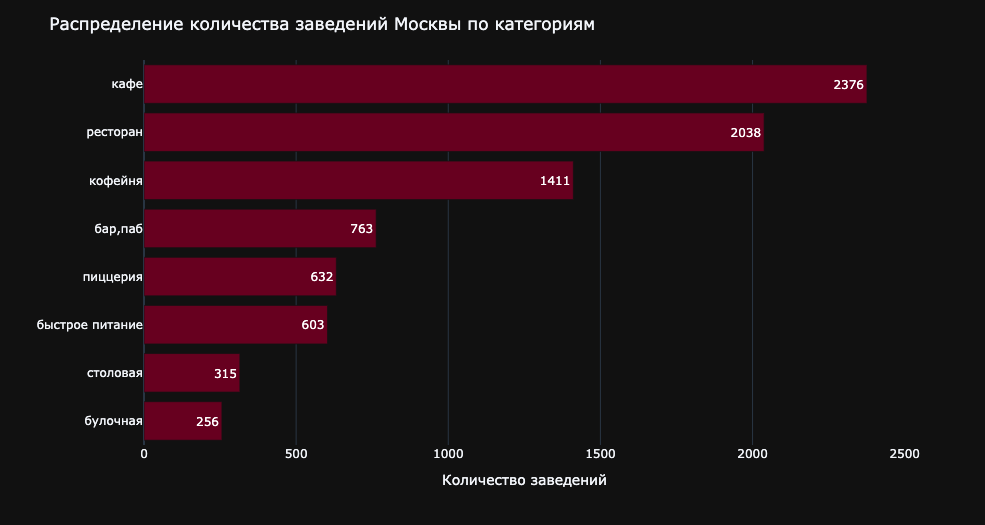

Объекты питания в представленных данных характеризуются одним из 9 типов. Таблица и визуализация рапределения этих типов по общему количеству показывает, что наиболее часто встречающиеся типы заведений - __кафе__, __рестораны__ и __кофейни__. На порядок меньше в Москве __булочных__ и __столовых__.

### Посадочные места по категориям

Рассмотрим категории заведений с точки зрения количества посадочных мест. При группировке возьмём не среднее, но медианное значение для того, чтобы уменьшить влияние оставшихся в датасете немногочисленных больших заведений. 

In [25]:
seats = (data 
             .query('seats >= 0')
             .groupby('category', as_index=False)
             .agg({'seats': 'median'})
             .sort_values(by = 'seats', ascending = False)
             .reset_index(drop=True)
         )

seats.columns = ['Категория', 'Медианное количество посадочных мест']

seats

,Категория,Медианное количество посадочных мест
0,ресторан,86.0
1,"бар,паб",82.0
2,кофейня,80.0
3,столовая,75.5
4,быстрое питание,65.0
5,кафе,60.0
6,пиццерия,53.5
7,булочная,50.0


In [26]:
fig = px.bar(
             seats.sort_values(by='Медианное количество посадочных мест', ascending=True), 
             x='Медианное количество посадочных мест',                                     
             y='Категория',                                                
             text='Медианное количество посадочных мест',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Медианное распределение количества посадочных мест по категориям заведений Москвы',
                  xaxis_title='Медианное количество посадочных мест',
                  yaxis_title='')
fig.show()

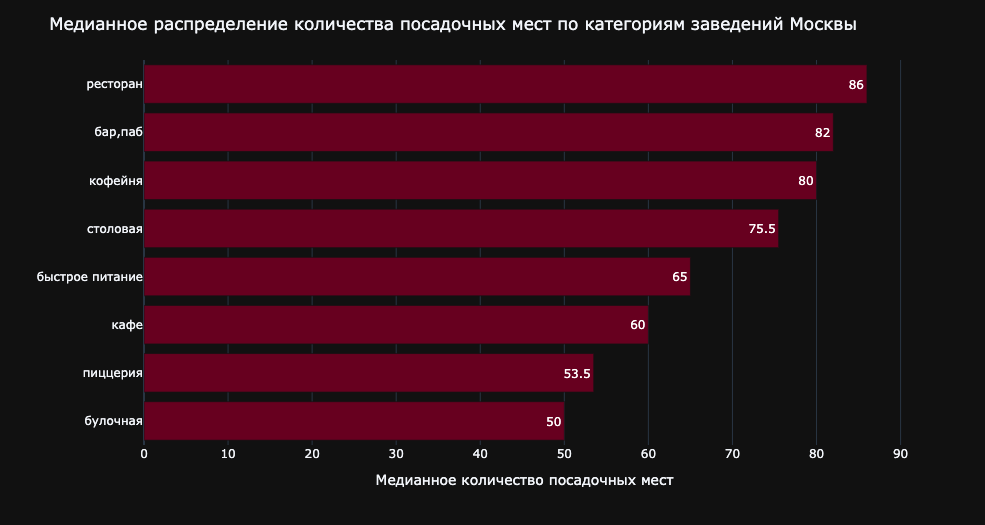

Разброс по медианному количеству посадочных мест по категориям небольшой: от 50 для булочных до 86 у ресторанов. Возможно, есть корреляция между количеством посадочных мест и временем, которое посетитель уделяет посещению заведения.  

### Cоотношение сетевых и несетевых заведений

In [27]:
chain = (data 
             .groupby('chain', as_index=False)
             .agg({'name': 'count'})
             .sort_values(by = 'name', ascending = False)
             .reset_index(drop=True)
         )

chain.columns = ['Сетевое заведение', 'Количество заведений']
chain['Сетевое заведение'] = chain['Сетевое заведение'].astype(bool)
chain['Доля от общего количества'] = round((chain['Количество заведений'] / chain['Количество заведений'].sum()),2) 

chain.loc[(chain['Сетевое заведение'] == False),'Сетевое заведение'] = 'Несетевое'
chain.loc[(chain['Сетевое заведение'] == True),'Сетевое заведение'] = 'Сетевое'

chain

,Сетевое заведение,Количество заведений,Доля от общего количества
0,Несетевое,5121,0.62
1,Сетевое,3156,0.38


In [28]:
fig = px.pie(chain, 
             values='Доля от общего количества', 
             names='Сетевое заведение', 
             color_discrete_sequence=px.colors.sequential.RdBu,
             title='Распределение заведений по принадлежности к франшизам')
fig.show()

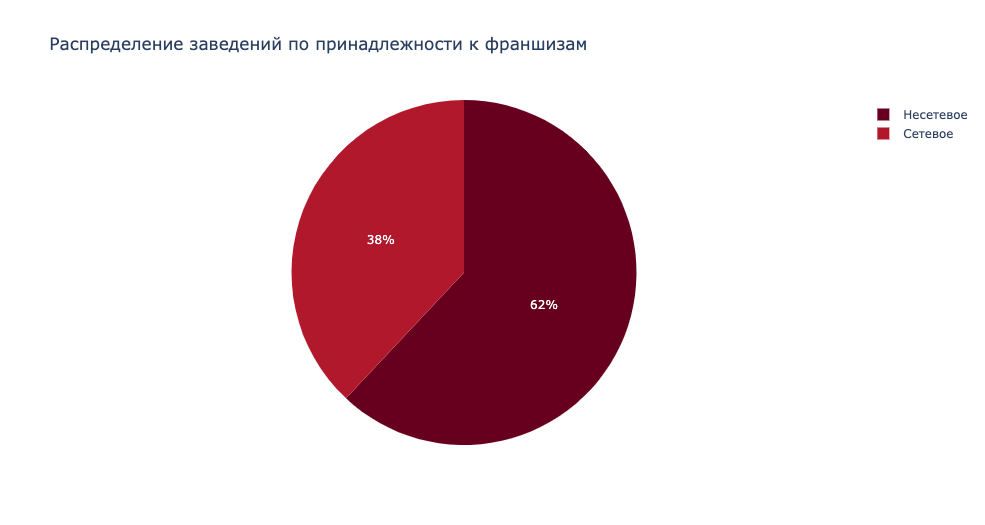

In [29]:
chain = data.query('chain == 1')

chain  = (chain 
               .groupby('name', as_index=False)
               .agg({'address': 'nunique'})
               .sort_values(by = 'address', ascending = False)
               .reset_index(drop=True)
         )

chain.columns = ['Название сети', 'Количество заведений']

display(chain.head(10))

,Название сети,Количество заведений
0,Шоколадница,120
1,Домино'с Пицца,76
2,Додо Пицца,74
3,One Price Coffee,69
4,Яндекс Лавка,68
5,Cofix,65
6,Prime,50
7,Хинкальная,44
8,КОФЕПОРТ,42
9,Теремок,38


По общему количеству заведений сетевые объекты питания уступают несетевым в Москве. 61.9 % заведений не принадлежат к какой-либо франшизе. Среди 10 наиболее распространённых франшиз - 4 кофейни: __Шоколадница__, __One Price Coffee__, __Cofix__ и __КОФЕПОРТ__.

### Категории заведений и франшизы

In [30]:
types = (data
             .groupby(['category', 'chain'], as_index=False)
             .agg({'name': 'count'})
             .reset_index(drop=True)
        )

#types['chain'] = types['chain'].astype(bool)

types.columns = ['Категория', 'Сетевое заведение', 'Количество заведений']
types.loc[(types['Сетевое заведение'] == 0),'Сетевое заведение'] = 'Несетевое'
types.loc[(types['Сетевое заведение'] == 1),'Сетевое заведение'] = 'Сетевое'

types['Всего заведений в категории'] = types.groupby('Категория')['Количество заведений'].transform('sum')

types

,Категория,Сетевое заведение,Количество заведений,Всего заведений в категории
0,"бар,паб",Несетевое,591,758
1,"бар,паб",Сетевое,167,758
2,булочная,Несетевое,98,253
3,булочная,Сетевое,155,253
4,быстрое питание,Несетевое,363,590
5,быстрое питание,Сетевое,227,590
6,кафе,Несетевое,1561,2326
7,кафе,Сетевое,765,2326
8,кофейня,Несетевое,682,1387
9,кофейня,Сетевое,705,1387


In [31]:
fig = px.bar(
             types.sort_values(by='Всего заведений в категории', ascending=True), 
             x='Количество заведений',                                     
             y='Категория',                                                
             text='Количество заведений',
             color = 'Сетевое заведение',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Распределение количества заведений Москвы по категориям и сетям',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

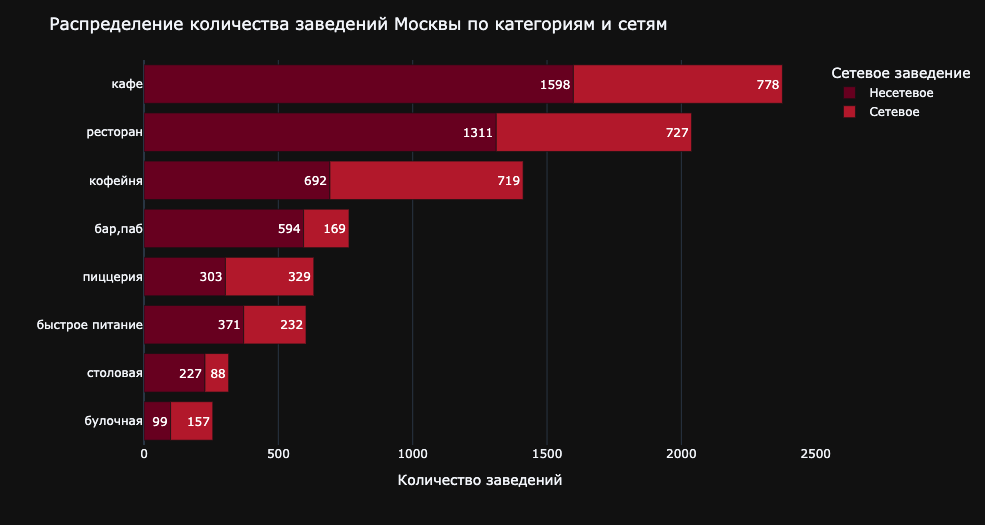

Только в трех категориях заведений преобладают сетевые - __кофейни__, __пиццерии__ и __булочные__. При этом в абсолютном количестве сетевые __рестораны__ и __кафе__ не уступают __кофейням__.

### Топ-15 популярных сетей в Москве

In [32]:
chains = data.query('chain == 1')

chains_by_name = (chains
                        .groupby(['name','category'], as_index=False)
                        .agg({'address': 'count'})
                        .sort_values(by='address', ascending=False)
                        .reset_index(drop=True)
                  ).head(15)

chains_by_name.columns = ['Название сети заведений', 'Категория', 'Количество заведений в сети']

chains_by_name

,Название сети заведений,Категория,Количество заведений в сети
0,Шоколадница,кофейня,119
1,Домино'с Пицца,пиццерия,76
2,Додо Пицца,пиццерия,74
3,One Price Coffee,кофейня,69
4,Яндекс Лавка,ресторан,68
5,Cofix,кофейня,65
6,Prime,ресторан,49
7,КОФЕПОРТ,кофейня,42
8,Кулинарная лавка братьев Караваевых,кафе,37
9,Теремок,ресторан,36


In [33]:
fig = px.bar(
             chains_by_name.sort_values(by='Количество заведений в сети', ascending=False), 
             x='Количество заведений в сети',                                     
             y='Название сети заведений',                                                
             text='Количество заведений в сети',
             color_discrete_sequence=px.colors.sequential.RdBu,
             color = 'Категория',
             template="plotly_dark"
            )

fig.update_layout(title='Топ-15 франшиз Москвы по количеству заведений с учётом категории',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

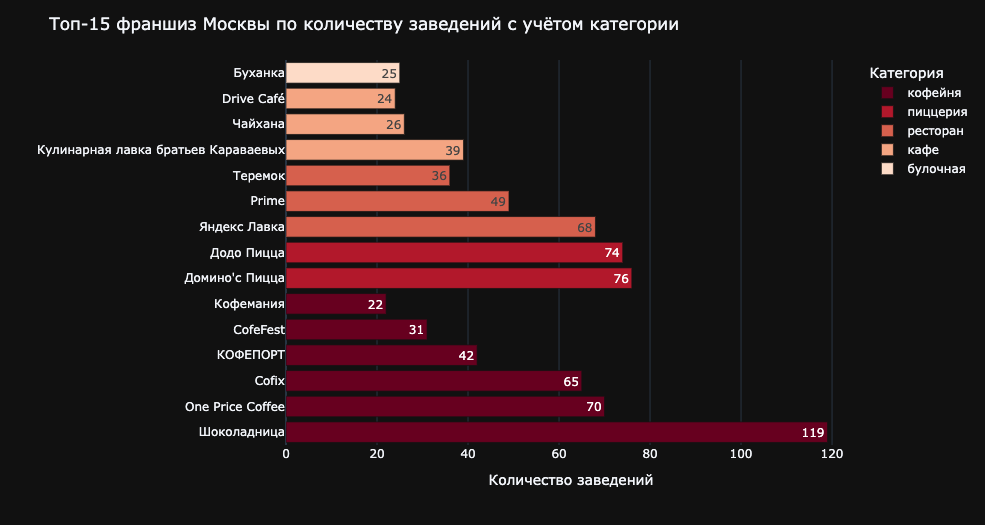

Среди 15 самых популярных сетей Москвы имена хорошо известных сетей, таких как __Шоколадница__, __Кулинарная лавка братьев Караваевых__ и __Prime__. Если смотреть категории заведений, то явно преобладают сетевые __кофейни__, их среди самых широко-развернувшихся сетей - 6 представителей.

### Категории заведений по районам

В датасете заведения распределены по 9 административным районам. Для удобства дальнейшего анализа заменим названия административных районов аббревиатурами.

In [34]:
data.loc[(data['district'] == 'Северный административный округ'),'district'] =        'САО'
data.loc[(data['district'] == 'Северо-Восточный административный округ'),'district'] = 'СВАО'
data.loc[(data['district'] == 'Северо-Западный административный округ'),'district'] =  'СЗАО'
data.loc[(data['district'] == 'Западный административный округ'),'district'] =        'ЗАО'
data.loc[(data['district'] == 'Центральный административный округ'),'district'] =     'ЦАО'
data.loc[(data['district'] == 'Восточный административный округ'),'district'] =       'ВАО'
data.loc[(data['district'] == 'Юго-Восточный административный округ'),'district'] =   'ЮВАО'
data.loc[(data['district'] == 'Южный административный округ'),'district'] =          'ЮАО'
data.loc[(data['district'] == 'Юго-Западный административный округ'),'district'] =    'ЮЗАО'

И добавим к сгруппированной по административным округам таблице данные по площади районов и количеством жителей на 2021 год.

In [35]:
list_values = [['ЦАО', 66.18, 772258], 
               ['САО', 113.73, 1204088], 
               ['СВАО', 101.88, 1437668], 
               ['ВАО', 154.84, 1512946], 
               ['ЮВАО', 117.56, 1492257],
               ['ЮАО', 131.77, 1789371], 
               ['ЮЗАО', 111.36, 1431903], 
               ['ЗАО', 153.03, 1437153], 
               ['СЗАО', 93.28, 1031149]] 

regions_info = pd.DataFrame(list_values, columns = ['district', 'area', 'population']) 

regions = (data
             .groupby(['district'], as_index=False)
             .agg({'name': 'count'})
             .reset_index(drop=True)
          )

regions = pd.merge(regions, regions_info, how ='inner', on ='district')

regions.columns = ['Административный округ', 'Количество заведений', 'Площадь округа', 'Население']

display(regions.sort_values(by='Население', ascending=True))

,Административный округ,Количество заведений,Площадь округа,Население
5,ЦАО,2213,66.18,772258
4,СЗАО,404,93.28,1031149
2,САО,891,113.73,1204088
8,ЮЗАО,692,111.36,1431903
1,ЗАО,831,153.03,1437153
3,СВАО,881,101.88,1437668
7,ЮВАО,703,117.56,1492257
0,ВАО,785,154.84,1512946
6,ЮАО,877,131.77,1789371


In [36]:
fig = px.bar(
              regions.sort_values(by='Количество заведений', ascending=True), 
              x='Количество заведений',                                     
              y='Административный округ',                                                
              text='Количество заведений',
              color = 'Население',
              template="plotly_dark",
              color_continuous_scale='YlOrRd'
             )

fig.update_layout(title='Распределение количества заведений Москвы по районам',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

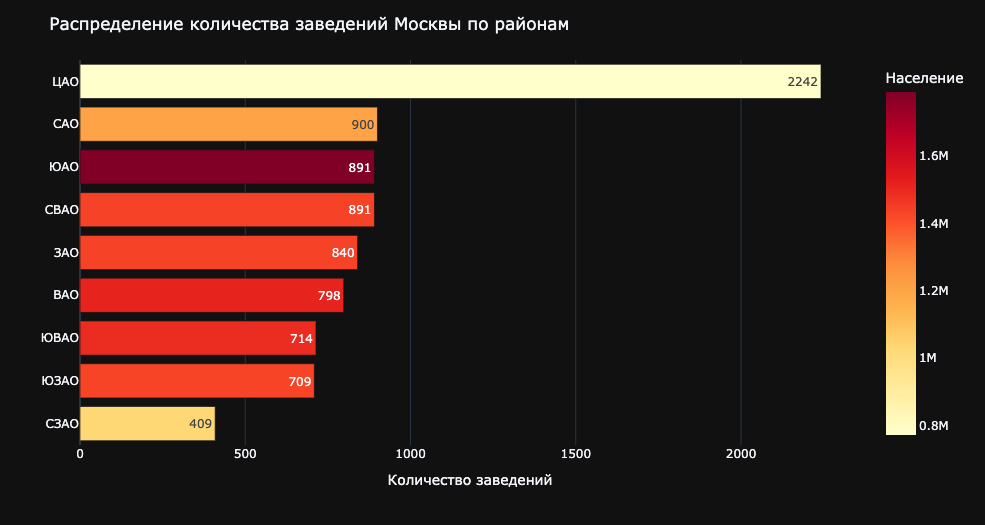

Объекты общественного питания распределены по Москве неравномерно и в __ЦАО__ сосредоточена большая часть всех объектов. 

Можно предположить, что объекты общественного питания люди посещают в отличных от места прописки районах. Возможно, недалеко от их места работы. 

Построенная зависимость также отражает слабую корреляцию между количеством населения и количеством заведений питания. Например, в __ЮАО__ проживает почти 1.8 млн человек, при этом количество заведений там такое же, что и в __САО__, где живет на 600 тысяч человек меньше.

При этом самое маленькое количество заведений зарегистрировано на территории __СЗАО__, что могло бы быть объяснено наименьшим среди других районов населением.

In [37]:
regions = (data
             .groupby(['district', 'category'], as_index=False)
             .agg({'name': 'count'})
             .reset_index(drop=True)
          )

regions.columns = ['Административный округ', 'Категория заведения', 'Количество заведений']

regions['Всего заведений в округе'] = regions.groupby('Административный округ')['Количество заведений'].transform('sum')

regions

,Административный округ,Категория заведения,Количество заведений,Всего заведений в округе
0,ВАО,"бар,паб",52,785
1,ВАО,булочная,25,785
2,ВАО,быстрое питание,69,785
3,ВАО,кафе,264,785
4,ВАО,кофейня,104,785
...,...,...,...,...
67,ЮЗАО,кафе,231,692
68,ЮЗАО,кофейня,94,692
69,ЮЗАО,пиццерия,63,692
70,ЮЗАО,ресторан,165,692


In [38]:
fig = px.bar(
              regions.sort_values(by='Всего заведений в округе', ascending=True), 
              x='Количество заведений',                                     
              y='Административный округ',                                                
              text='Количество заведений',
              color = 'Категория заведения',
              color_discrete_sequence=px.colors.sequential.RdBu,
              template="plotly_dark"
             )

fig.update_layout(title='Распределение количества заведений Москвы по районам и категориям',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

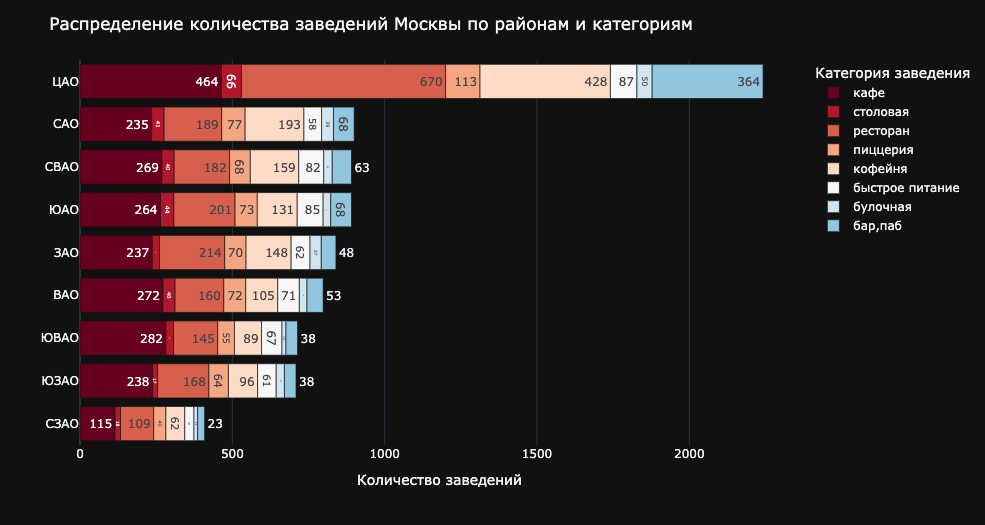

__ЦАО__ выделяется по общему количеству заведений и также превосходит все районы по количеству заведений в каждой из 8 категорий объектов питания. По-сравнению с другими районами, характерным для __ЦАО__ является большая доля __ресторанов__ и __кофеен__. Из-за того, что в одном из районом сосредоточены больше четверти всех заведений, визуализация распределения может быть сложна в чтении, поэтому построим тот же график без учёта __ЦАО__.

In [39]:
regions = (data
             .query('district != "ЦАО"')
             .groupby(['district', 'category'], as_index=False)
             .agg({'name': 'count'})
             .reset_index(drop=True)
          )

regions.columns = ['Административный округ', 'Категория заведения', 'Количество заведений']

regions['Всего заведений в округе'] = regions.groupby('Административный округ')['Количество заведений'].transform('sum')

fig = px.bar(
             regions.sort_values(by='Всего заведений в округе', ascending=True), 
             x='Количество заведений',                                     
             y='Административный округ',                                                
             text='Количество заведений',
             color = 'Категория заведения',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Распределение количества заведений Москвы по районам и категориям без учёта ЦАО',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

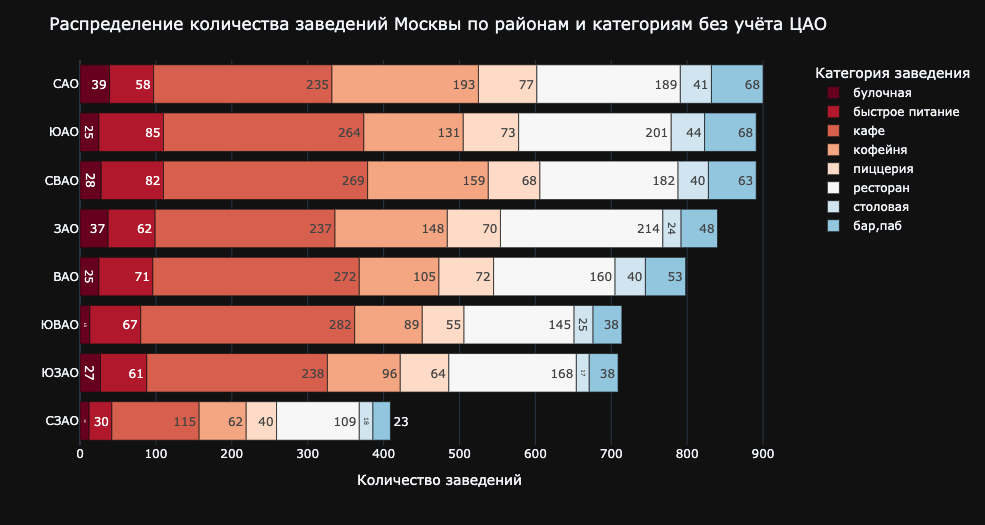

Для всех административных округов, окружающих центр, доля каждой из категорий приблизительно одинакова. Если не учитывать __ЦАО__, больше всего ресторанов в __ЗАО__, объектов быстрого питания и столовых - в __ЮАО__, а пиццерий, кофеен и баров в __САО__.

### Средний рейтинг по категориям заведений

In [40]:
ratings = (data
               .groupby(['category'], as_index=False)
               .agg({'rating': 'mean'})
               .reset_index(drop=True)
           )

ratings.columns = ['Категория заведения', 'Средний рейтинг']
ratings['Средний рейтинг'] = round((ratings['Средний рейтинг']),2)

ratings

,Категория заведения,Средний рейтинг
0,"бар,паб",4.39
1,булочная,4.27
2,быстрое питание,4.05
3,кафе,4.12
4,кофейня,4.28
5,пиццерия,4.30
6,ресторан,4.29
7,столовая,4.21


In [41]:
fig = px.bar(
             ratings.sort_values(by='Средний рейтинг', ascending=True), 
             x='Средний рейтинг',                                     
             y='Категория заведения',                                                
             text='Средний рейтинг',
             color='Средний рейтинг',
             color_continuous_scale='YlGn',
             template="plotly_dark"
            )

fig.update_layout(title='Распределение средних оценок заведений Москвы по категориям',
                  xaxis_title='Средний рейтинг',
                  yaxis_title='',
                  xaxis_range=[4,4.4])

fig.show()

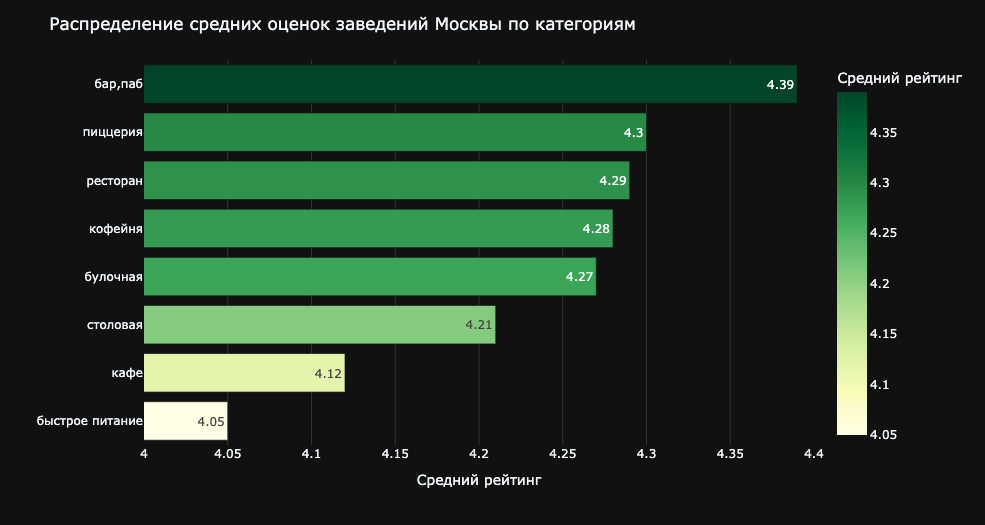

Визуализация средних оценок по категориям заведений показывает, что лучшие отзывы получают __бары__. Наименьший средний рейтинг у заведений __быстрого питания__. Рейтинг __ресторанов__, __кофеен__ и __булочных__ почти не отличается. Диапазон разброса средних оценок невысок: от 4.05 до 4.39.

### Картограмма средних рейтингов заведений по районам

In [42]:
region_rating = (data
                     .groupby(['district'], as_index=False)
                     .agg({'rating': 'mean'})
                     .reset_index(drop=True)
                )

region_rating.columns = ['Административный округ', 'Средний рейтинг']
region_rating['Средний рейтинг'] = round((region_rating['Средний рейтинг']),2)

fig = px.bar(
             region_rating.sort_values(by='Средний рейтинг', ascending=True), 
             x='Средний рейтинг',                                     
             y='Административный округ',                                                
             text='Средний рейтинг',
             color='Средний рейтинг',
             color_continuous_scale='YlGn',
             template="plotly_dark"
            )

fig.update_layout(title='Распределение средних оценок заведений Москвы по административным округам',
                  xaxis_title='Средний рейтинг',
                  yaxis_title='',
                  xaxis_range=[4,4.4])

fig.show()

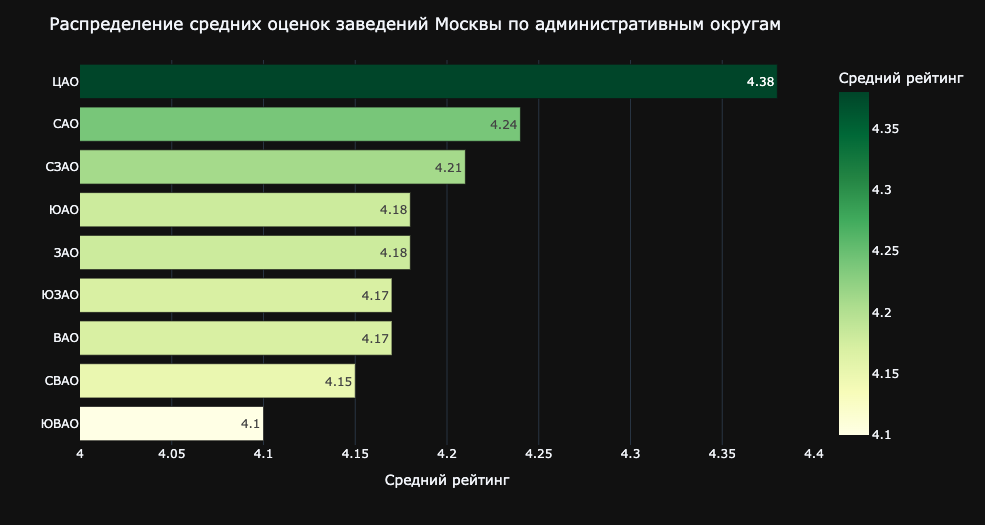

In [43]:
region_rating.loc[(region_rating['Административный округ'] == 'САО'),'Административный округ'] = 'Северный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'СВАО'),'Административный округ'] = 'Северо-Восточный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'СЗАО'),'Административный округ'] = 'Северо-Западный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'ЗАО'),'Административный округ'] = 'Западный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'ЦАО'),'Административный округ'] = 'Центральный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'ВАО'),'Административный округ'] = 'Восточный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'ЮВАО'),'Административный округ'] = 'Юго-Восточный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'ЮАО'),'Административный округ'] = 'Южный административный округ'
region_rating.loc[(region_rating['Административный округ'] == 'ЮЗАО'),'Административный округ'] = 'Юго-Западный административный округ'

In [44]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
            geo_data=state_geo,
            data=region_rating,
            columns=['Административный округ', 'Средний рейтинг'],
            key_on='feature.name',
            fill_color='YlGn',
            fill_opacity=0.6,
            legend_name='Средний рейтинг заведений по районам',
          ).add_to(m)

m

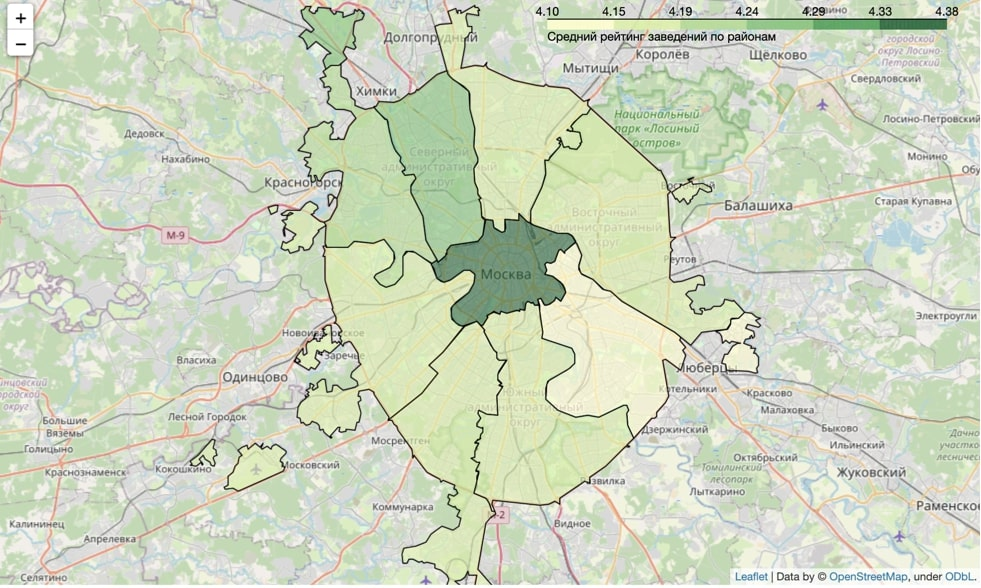

Средние оценки по районам варьируются между 4.10 и 4.38. Средние рейтинги выше у заведений в центре города в округе __ЦАО__. Сравнительно высокими оценками также отличаются районы на севере города - __САО__ и __СЗАО__. Самые низкие рейтинги у заведений, расположенных в районе __ЮВАО__.

### Все заведения на карте 

In [45]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
            [row['lat'], row['lng']],
            popup=f"{row['name']} {row['rating']}",
          ).add_to(marker_cluster)

data.apply(create_clusters, axis=1)

m

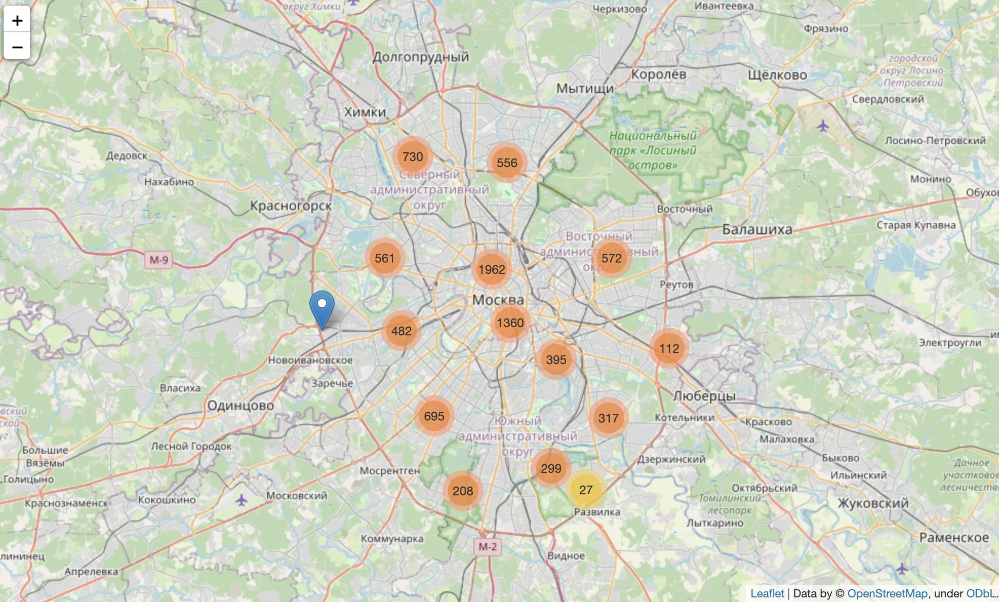

Все заведения, представленные в данных для анализа, нанесены на интерактивную кластерную карту. Можно видеть высокую концентрацию заведений в центре города без привязки к административному округу.

### Топ-15 улиц по количеству заведений

In [46]:
streets = (
           (
            (data
               .groupby(['street'], as_index=False)
               .agg({'name': 'count'})
               .reset_index(drop=True)
            )
           ).sort_values(by = 'name',ascending=False)
          ).head(15)

streets.columns = ['Улица', 'Количество заведений']

streets

,Улица,Количество заведений
1046,проспект Мира,184
763,Профсоюзная улица,122
521,Ленинский проспект,107
1043,проспект Вернадского,97
519,Ленинградский проспект,95
372,Дмитровское шоссе,88
453,Каширское шоссе,76
302,Варшавское шоссе,75
520,Ленинградское шоссе,69
543,МКАД,65


In [47]:
fig = px.bar(
             streets.sort_values(by='Количество заведений', ascending=True), 
             x='Количество заведений',                                     
             y='Улица',                                                
             text='Количество заведений',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Распределение заведений по улицам Москвы Топ-15',
                  xaxis_title='Количество заведений',
                  yaxis_title='')

fig.show()

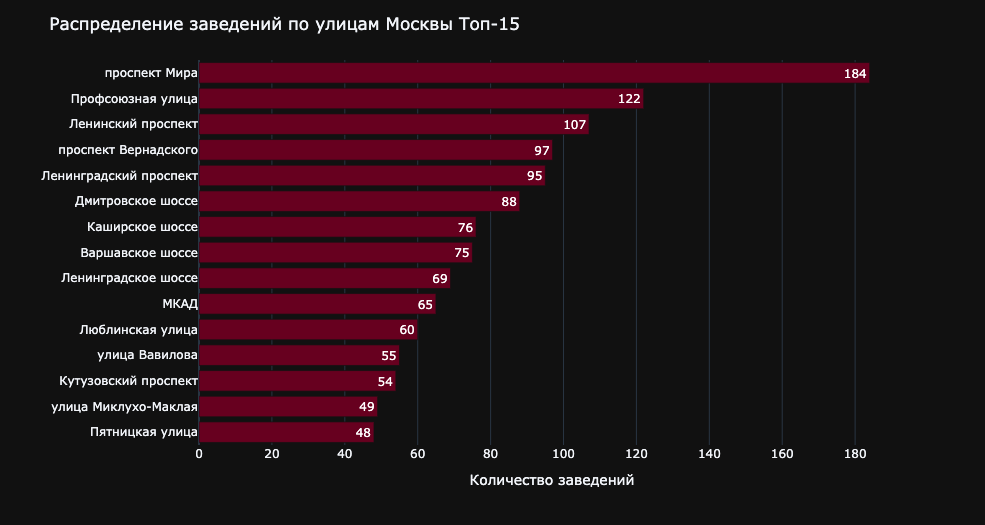

In [48]:
most_popular_streets = streets['Улица'].tolist()

streets =  (
            (data.query('street in @most_popular_streets')
                 .groupby(['street', 'category'], as_index=False)
                 .agg({'name': 'count'})
                 .reset_index(drop=True)
            )
           ).sort_values(by = 'name',ascending=False)

streets.columns = ['Улица', 'Категория заведения', 'Количество заведений']

streets['Всего заведений на улице'] = streets.groupby('Улица')['Количество заведений'].transform('sum')

streets

,Улица,Категория заведения,Количество заведений,Всего заведений на улице
93,проспект Мира,кафе,53,184
63,МКАД,кафе,45,65
96,проспект Мира,ресторан,45,184
94,проспект Мира,кофейня,36,184
70,Профсоюзная улица,кафе,35,122
...,...,...,...,...
23,Кутузовский проспект,булочная,1,54
83,проспект Вернадского,булочная,1,97
58,Люблинская улица,пиццерия,1,60
66,МКАД,столовая,1,65


In [49]:
fig = px.bar(
             streets.sort_values(by='Всего заведений на улице', ascending=True),
             x='Количество заведений',                                     
             y='Улица',                                                
             text='Количество заведений',
             color='Категория заведения',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Распределение количества заведений Москвы по улицам и категориям',
                  xaxis_title='Количество заведений',
                  yaxis_title='')
fig.show()

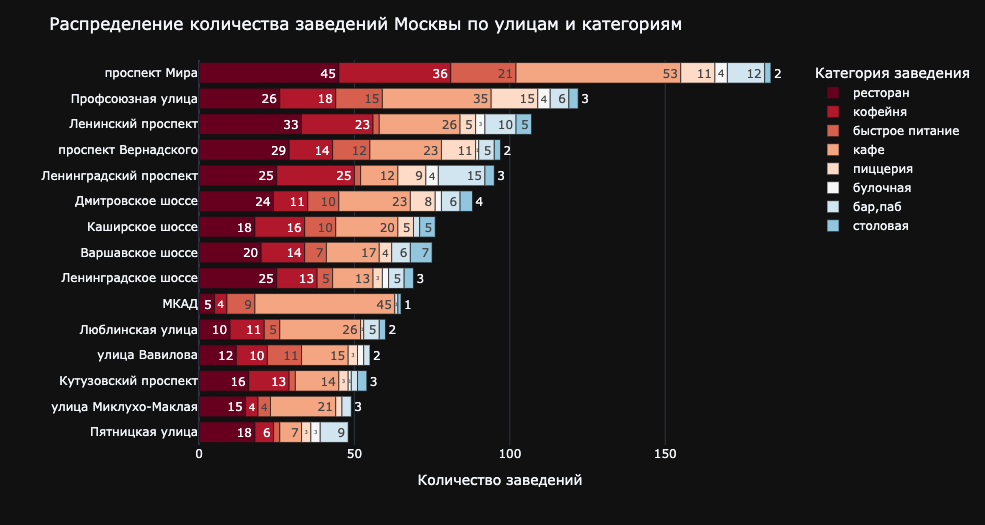

Среди улиц с наибольшим количеством заведений оказались самые длинные улицы Москвы, включая несколько шоссе, проспектов и даже МКАД. На __Проспект Мира__, __Профсоюзной__ и __Ленинском проспекте__ суммарное чило заведений оказалось больше 100. __Профсоюзная улица__ длиной в 10 км - самая длинная дорога в Москве, которая носит слово "улица" в названии. Большое количество объектов питания на ней неудивительно.
__Проспект Мира__ - короче на 1.5 км, чем __Профсоюзная__, но проходит через многолюдные районы у метро Сухаревская, Рижского вокзала и популярного туристического района ВДНХ. Этим можно объяснить абсолютное лидерство этой улицы с 184-мя заведениями на ней. 

### Топ-15 улиц по удельному количеству заведений

Судить улицы по количеству заведений без учета их длины, как было сказано выше, не совсем справедливо. С помощью чат-бота с искусственным интеллектом __ChatGPT__ была составлена таблица всех представленных в датасете улиц Москвы с указанием их длины в км.

In [50]:
# чтение и сохранение созданной нейроетью таблицы
streets_length = pd.read_excel('streets.xlsx')

streets_length.columns = ['Улица', 'Длина, км']

display(streets_length)

,Улица,"Длина, км"
0,МКАД,109.9
1,Ленинградское шоссе,47.2
2,Каширское шоссе,33.6
3,Рублёвское шоссе,28.6
4,Можайское шоссе,24.4
...,...,...
1008,Новоселенский переулок,0.1
1009,Малый Черкасский переулок,0.1
1010,2-й Котляковский переулок,0.1
1011,Плотников переулок,0.1


При этом нужно понимать, что данные полученные таким способом могут быть неточными и к ним нужно относиться с осторожностью.

In [51]:
# повторная группировка датасета по улицам и подсчет количества заведений на каждой
streets = (
           (data
                .groupby(['street'], as_index=False)
                .agg({'name': 'count'})
                .reset_index(drop=True)
           )
          ).sort_values(by = 'name',ascending=False)

streets.columns = ['Улица', 'Количество заведений']

streets = streets.reset_index(drop=True)

# соединение двух таблиц с количесвтом заведений и их длиной
streets = pd.merge(streets, streets_length, how ='inner', on ='Улица')

# добавление нового столбца с удельным количеством заведений на 1 км длины
streets['Удельное количество заведений, шт/км'] = streets['Количество заведений'] / streets['Длина, км']
streets['Удельное количество заведений, шт/км'] = streets['Удельное количество заведений, шт/км'].round(1)

streets = streets.sort_values(by = 'Удельное количество заведений, шт/км', ascending = False)

Также отфильтруем получившуюся таблицу по количеству заведений, установим планку в минимум 10 заведений на улице. Таким образом, можно будет найти популярные улицы с высокой плотностью заведений, а не самые короткие с несколькими объектами общественного питания. Отфильтровав таблицу, выведем 15 улиц с самым высокой плотностью заведений на километр.

In [52]:
streets = streets[streets['Количество заведений'] >= 10]

streets.head(15)

,Улица,Количество заведений,"Длина, км","Удельное количество заведений, шт/км"
88,Нижний Сусальный переулок,17,0.1,170.0
128,Столярный переулок,14,0.2,70.0
154,Валовая улица,12,0.2,60.0
32,Кронштадтский бульвар,34,0.6,56.7
111,Большой Саввинский переулок,15,0.3,50.0
51,Мясницкая улица,25,0.6,41.7
92,Широкая улица,16,0.4,40.0
53,улица Перерва,24,0.6,40.0
105,Рочдельская улица,15,0.4,37.5
101,Мытная улица,15,0.4,37.5


В Топ-15 улиц с самой высокой плотностью заведений можно ожидаемо обнаружить:

- Нижний Сусальный переулок - культурный центр АРМА 
- Рочдельская улица - культурный центр Трехгорная Мануфактура
- Валовая улица - часть Садового кольца

с большим количеством заведений зарегестрированных на ближайшей улице.

Но длина таких улиц как:

- Кронштадтский бульвар
- Мытная улица
- Столярный переулок
- Страстной бульвар
- Улица Барклая
- Улица Свободы

была определена неверно, а именно, занижено, что привело к попаданию этих улиц в Топ-15 по плотности заведений.

Полученная таблица подтверждает высокую плотность заведений в культурных центрах и в пределах садового кольца Москвы, а также тот факт, что запросы информации у нейросети требует дополнительной верификации.

### Улицы с одним объектом общепита

In [53]:
lonely = (
          (data
               .groupby(['street'], as_index=False)
               .agg({'name': 'count'})
               .reset_index(drop=True)
          )
         ).query('name == 1')

lonely.columns = ['Улица', 'Количество заведений']

lonely_streets = lonely['Улица'].tolist()

lonely_meals = data.query('street in @lonely_streets')

lonely_meals

,name,category,chain,seats,address,street,district,lat,lng,hours,is_24/7,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup
15,Дом обеда,столовая,0,180.0,"Москва, улица Бусиновская Горка, 2",улица Бусиновская Горка,САО,55.885890,37.493264,пн-пт 08:30–18:30; сб 10:00–20:00,False,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN
21,7/12,кафе,0,NaN,"Москва, Прибрежный проезд, 7",Прибрежный проезд,САО,55.876805,37.464934,"ежедневно, 10:00–22:00",False,4.5,NaN,NaN,NaN,NaN
58,Coffeekaldi's,кофейня,1,NaN,"Москва, Угличская улица, 13, стр. 8",Угличская улица,СВАО,55.900316,37.570558,"ежедневно, 09:00–22:00",False,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN
71,CofeFest,кофейня,1,NaN,"Москва, Новгородская улица, 23А",Новгородская улица,СВАО,55.901799,37.577672,пн-пт 08:00–19:00,False,4.1,NaN,NaN,NaN,NaN
97,Жигулевское,"бар,паб",0,NaN,"Москва, Бибиревская улица, 7к2",Бибиревская улица,СВАО,55.879733,37.593734,"пн-чт 14:00–00:00; пт,сб 14:00–02:00; вс 14:00...",False,4.5,средние,Цена бокала пива:90–230 ₽,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8289,Мираж,ресторан,0,90.0,"Москва, улица Шкулёва, 2А",улица Шкулёва,ЮВАО,55.693340,37.746231,"пн-пт 11:00–23:00; сб,вс 11:00–00:00",False,4.7,NaN,NaN,NaN,NaN
8294,WTFcoffee,кофейня,0,NaN,"Москва, улица Артюхиной, 14/8с1",улица Артюхиной,ЮВАО,55.699044,37.737790,"ежедневно, 10:00–22:00",False,4.4,средние,NaN,NaN,NaN
8317,Беседка,кафе,1,NaN,"Москва, Кузьминская улица, 10",Кузьминская улица,ЮВАО,55.690691,37.787735,"ежедневно, 11:00–23:00",False,4.1,NaN,NaN,NaN,NaN
8379,Лагман Хаус,кафе,1,40.0,"Москва, Новороссийская улица, 14, стр. 2",Новороссийская улица,ЮВАО,55.678772,37.759422,"ежедневно, 10:00–00:00",False,4.3,NaN,NaN,NaN,NaN


In [54]:
lonely_meals.describe()

,chain,seats,lat,lng,rating,middle_avg_bill,middle_coffee_cup
count,424.000000,160.000000,424.000000,424.000000,424.000000,163.000000,24.000000
mean,0.273585,58.625000,55.760140,37.616012,4.238915,969.613497,186.166667
std,0.446325,47.856934,0.060949,0.093299,0.452385,1007.635463,55.544472
min,0.000000,0.000000,55.578830,37.387459,1.000000,67.000000,95.000000
25%,0.000000,30.000000,55.731973,37.562491,4.100000,325.000000,140.000000
50%,0.000000,45.000000,55.761636,37.612047,4.300000,650.000000,177.500000
75%,1.000000,80.000000,55.795059,37.665188,4.500000,1250.000000,213.750000
max,1.000000,240.000000,55.914074,37.867004,5.000000,7000.000000,320.000000


In [55]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
            [row['lat'], row['lng']],
            popup=f"{row['name']} {row['rating']}",
          ).add_to(marker_cluster)

lonely_meals.apply(create_clusters, axis=1)

m

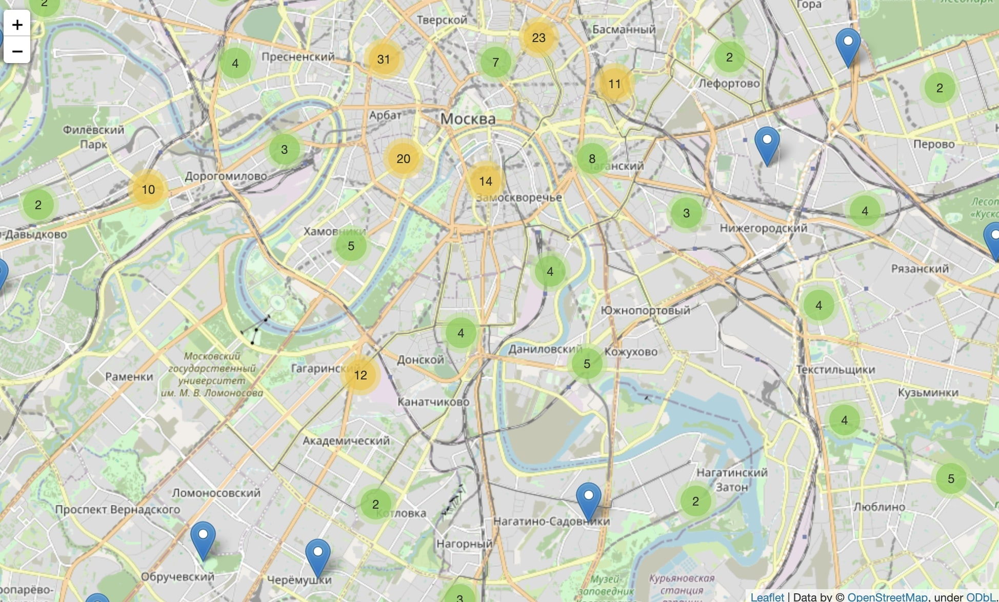

In [56]:
lonely_meals = (lonely_meals
                            .groupby('category', as_index=False)
                            .agg({'name': 'count'})
                            .sort_values(by = 'name', ascending = False)
                            .reset_index(drop=True)
                )

lonely_meals.columns = ['Категория', 'Количество заведений']

lonely_meals

,Категория,Количество заведений
0,кафе,144
1,ресторан,91
2,кофейня,74
3,"бар,паб",38
4,столовая,36
5,быстрое питание,19
6,пиццерия,15
7,булочная,7


На 424 улице Москвы зарегестрировано только по одному объекту питания. Не выявлено ни одной особенности заведений на этих улицах ни по категориям, ни по расположению, ни по другим численным метрикам, которыми они характеризуются. "Непопулярность" этих улиц можно объяснить короткой географической протяженностью. На коротких улицах - мало домов и мало объектов питания.

###  Средний счёт по районам 


In [57]:
average_bill = data.query('middle_avg_bill >= 0').reset_index(drop=True)  

average_bill

,name,category,chain,seats,address,street,district,lat,lng,hours,is_24/7,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup
0,Четыре комнаты,ресторан,0,4.0,"Москва, улица Дыбенко, 36, корп. 1",улица Дыбенко,САО,55.875801,37.484479,"ежедневно, 10:00–22:00",False,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN
1,Хазри,кафе,0,45.0,"Москва, Клязьминская улица, 15",Клязьминская улица,САО,55.889146,37.525901,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",False,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN
2,Иль Марко,пиццерия,1,148.0,"Москва, Правобережная улица, 1Б",Правобережная улица,САО,55.881166,37.449357,"ежедневно, 10:00–22:00",False,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN
3,Огни города,"бар,паб",0,45.0,"Москва, Клязьминская улица, 9, стр. 3",Клязьминская улица,САО,55.890752,37.524653,пн 15:00–04:00; вт-вс 15:00–05:00,False,4.4,средние,Средний счёт:199 ₽,199.0,NaN
4,Mr. Уголёк,быстрое питание,0,45.0,"Москва, Клязьминская улица, 9, стр. 3",Клязьминская улица,САО,55.890636,37.524303,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",False,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3113,Выхинский Дворик,кафе,0,32.0,"Москва, улица Хлобыстова, 22",улица Хлобыстова,ЮВАО,55.716368,37.813366,"ежедневно, 11:00–01:00",False,3.0,средние,Средний счёт:500–1000 ₽,750.0,NaN
3114,Pizza24/7,пиццерия,0,NaN,"Москва, улица Юных Ленинцев, 10/15к1",улица Юных Ленинцев,ЮВАО,55.698824,37.738878,"ежедневно, круглосуточно",True,4.2,NaN,Средний счёт:150 ₽,150.0,NaN
3115,Пекинский Двор,ресторан,0,200.0,"Москва, Ленинский проспект, 158",Ленинский проспект,ЗАО,55.651706,37.482667,"ежедневно, 11:00–23:00",False,4.3,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN
3116,"Пекарня, кафе-гриль",булочная,0,50.0,"Москва, Болотниковская улица, 52, корп. 2",Болотниковская улица,ЮЗАО,55.662866,37.582572,"ежедневно, круглосуточно",True,4.2,NaN,Средний счёт:50–250 ₽,150.0,NaN


In [58]:
average_bill = (data
                    .groupby(['district'], as_index=False)
                    .agg({'middle_avg_bill': 'median'})
                ).sort_values(by = 'middle_avg_bill', ascending = False)

average_bill.columns = ['Административный округ', 'Медиана среднего счета']

fig = px.bar(
             average_bill.sort_values(by='Медиана среднего счета', ascending=True), 
             x='Медиана среднего счета',                                     
             y='Административный округ',                                                
             text='Медиана среднего счета',
             color_continuous_scale='YlOrRd',
             color = 'Медиана среднего счета',
             template="plotly_dark"
            )

fig.update_layout(title='Медиана среднего счета заведений Москвы по административным округам',
                  xaxis_title='Средний счёт',
                  yaxis_title='',
                  xaxis_range=[400,1000])

fig.show()

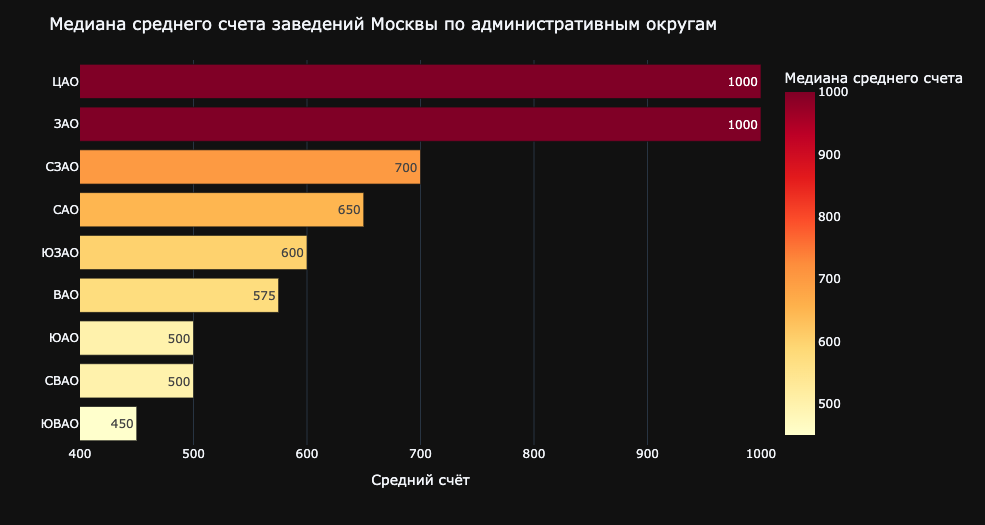

In [59]:
average_bill.loc[(average_bill['Административный округ'] == 'САО'),'Административный округ'] = 'Северный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'СВАО'),'Административный округ'] = 'Северо-Восточный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'СЗАО'),'Административный округ'] = 'Северо-Западный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'ЗАО'),'Административный округ'] = 'Западный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'ЦАО'),'Административный округ'] = 'Центральный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'ВАО'),'Административный округ'] = 'Восточный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'ЮВАО'),'Административный округ'] = 'Юго-Восточный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'ЮАО'),'Административный округ'] = 'Южный административный округ'
average_bill.loc[(average_bill['Административный округ'] == 'ЮЗАО'),'Административный округ'] = 'Юго-Западный административный округ'

In [60]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
            geo_data=state_geo,
            data=average_bill,
            columns=['Административный округ', 'Медиана среднего счета'],
            key_on='feature.name',
            fill_color='YlOrRd',
            fill_opacity=0.6,
            legend_name='Медиана среднего счета',
          ).add_to(m)

m

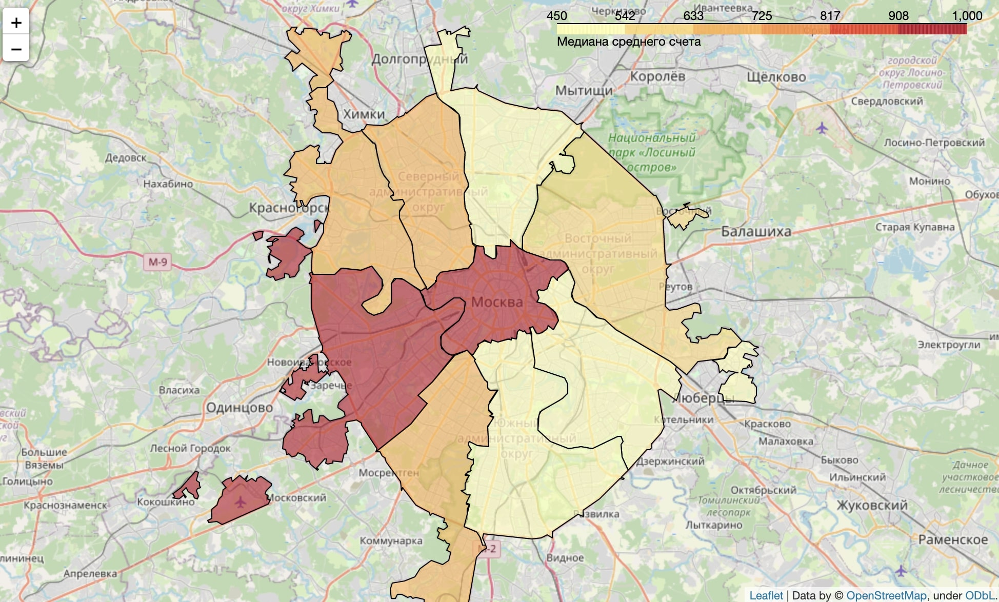

Для 3145 объектов питания есть информация по среднему чеку. Самые высокие значения среднего счёта в столбце __middle_avg_bill__ соответствуют заведениям, расположенным в __ЦАО__ и __ЗАО__. В этих районах медианная стоимость посещения составляет 1000 руб.

В __СВАО__, __ЮАО__ и __ЮВАО__ медианный средний чек в два раза меньше.

Если сравнить средний чек по всем административным районам, то наблюдается логичная тенденция - цены выше в центре города и уменьшаются для периферийных районов за одним исключением - цены в __ЗАО__ такие же высокие, как и в центре. 

In [61]:
average_bill = (data
                    .groupby(['district'], as_index=False)
                    .agg({'middle_avg_bill': 'median'})
                ).sort_values(by = 'middle_avg_bill', ascending = False)

average_bill.columns = ['Административный округ', 'Медиана среднего счета']

region_rating = (data.query('middle_avg_bill >= 0')
                     .groupby(['district'], as_index=False)
                     .agg({'rating': 'mean'})
                     .reset_index(drop=True)
                )

region_rating.columns = ['Административный округ', 'Средний рейтинг']
region_rating['Средний рейтинг'] = round((region_rating['Средний рейтинг']),2)

average_bill = pd.merge(average_bill, region_rating, how ='inner', on ='Административный округ')

average_bill

,Административный округ,Медиана среднего счета,Средний рейтинг
0,ЗАО,1000.0,4.27
1,ЦАО,1000.0,4.40
2,СЗАО,700.0,4.24
3,САО,650.0,4.27
4,ЮЗАО,650.0,4.25
5,ВАО,575.0,4.23
6,СВАО,500.0,4.19
7,ЮАО,500.0,4.24
8,ЮВАО,450.0,4.19


In [62]:
fig = px.bar(
             average_bill.sort_values(by='Медиана среднего счета', ascending=True), 
             x='Медиана среднего счета',                                     
             y='Административный округ',                                                
             text='Медиана среднего счета',
             color='Средний рейтинг',
             color_continuous_scale='YlGn',
             template="plotly_dark"
            )

fig.update_layout(title='Медиана среднего счета заведений Москвы по административным округам с учётом рейтинга',
                  xaxis_title='Медиана среднего счета',
                  yaxis_title='',
                  xaxis_range=[400,1000])

fig.show()

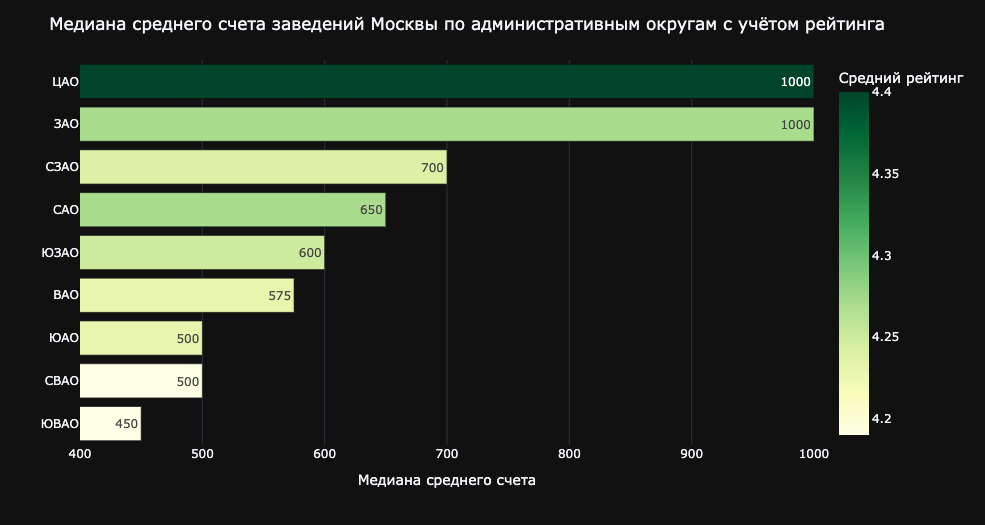

Если вновь взглянуть на распределение медианного чека в заведениях по административным районам с учётом среднего рейтинга заведений, для которых есть информация по среднему чеку, то можно увидеть, что есть чёткая зависимость между ожиданием посетителей и реальностью. Чем выше цены в заведении, тем выше оценки. Однако для __ЗАО__ эта зависимость выполняется плохо: при высоких ценах посетителя низко оценивают заведения в этом районе.

###  Промежуточный вывод

Если коротко привести информацию, полученную в разделе анализа данных рынка общественного питания Москвы, можно отметить следующее:

* наиболее популярные категории заведений - __кафе__, __рестораны__ и __кофейни__, наименее - __булочные__;
* наибольшим количеством посадочных мест характерны __рестораны__ и __бары__;
* доля __несетевых заведений__ составляет 62% от общего количества;
* самая большая сеть заведений в Москве - __кофейни Шоколадница__;
* четверть всех заведений питания расположены в пределах __ЦАО__;
* худшие средние оценки среди заведений по категориям у __быстрого питания__, лучшие - у __баров__;
* самые дорогие заведения расположены в __ЦАО__, самые бюджетные - в __ЮАО__. 

Заведения общественного питания Москвы характеризуются большим разнообразием категорий и ценами. Для наиболее эффективного анализа закономерностей, помимо указанных выше, следует рассматривать более узкие наборы данных.


## Детализированное исследование: открытие кофейни








В рамках исследования рынка общепита в Москве важным моментом является провести детальное исследование именно кофеен.

Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Заказчики отметили, что не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. 

Задачей является  определить, осуществима ли мечта владельцев инвестиционного фонда, проанализировав данные по кофейням в Москве.

### Распределение кофеен по районам

In [63]:
coffee = data.query('category == "кофейня"').reset_index(drop=True)

coffee.describe()

,chain,seats,lat,lng,rating,middle_avg_bill,middle_coffee_cup
count,1387.000000,748.000000,1387.000000,1387.000000,1387.000000,197.000000,519.000000
mean,0.508291,108.094920,55.756084,37.600031,4.277433,616.076142,172.400771
std,0.500112,112.647168,0.063850,0.089296,0.372507,504.455293,65.846649
min,0.000000,0.000000,55.581907,37.371261,1.400000,0.000000,60.000000
25%,0.000000,40.000000,55.721222,37.537323,4.100000,300.000000,124.000000
50%,1.000000,80.000000,55.759675,37.599372,4.300000,400.000000,169.000000
75%,1.000000,144.000000,55.795727,37.655926,4.400000,750.000000,225.000000
max,1.000000,1040.000000,55.920257,37.864105,5.000000,2500.000000,375.000000


In [64]:
coffee_by_region = (coffee
                          .groupby(['district'], as_index=False)
                          .agg({'name': 'count'})
                          .sort_values(by = 'name', ascending = False)
                          .reset_index(drop=True)
                    )

coffee_by_region.columns = ['Административный округ', 'Количество кофеен']

fig = px.bar(
             coffee_by_region.sort_values(by='Количество кофеен', ascending=True), 
             x='Количество кофеен',                                     
             y='Административный округ',                                                
             text='Количество кофеен',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Количество кофеен по административным округам',
                  xaxis_title='Количество кофеен',
                  yaxis_title='',
                  xaxis_range=[0,450])

fig.show()

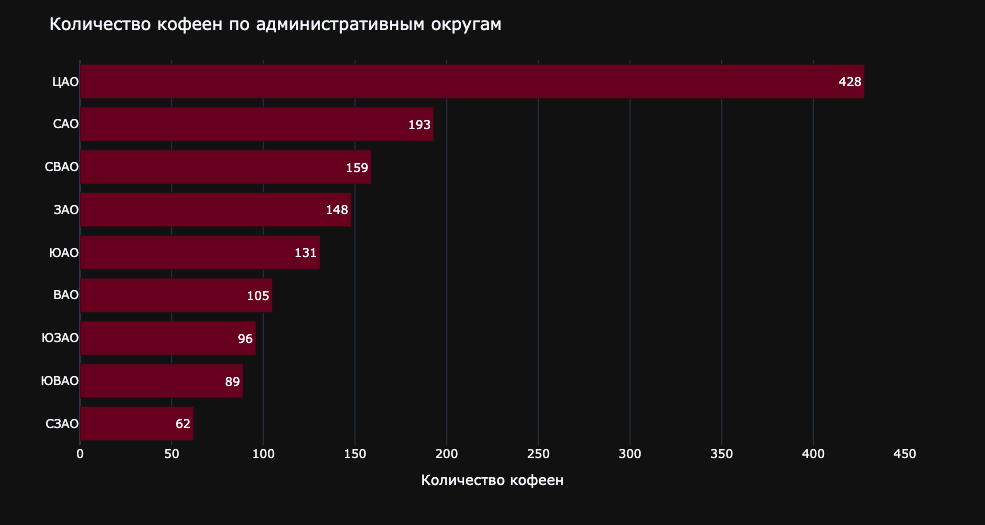

In [65]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
            [row['lat'], row['lng']],
            popup=f"{row['name']} {row['rating']}",
          ).add_to(marker_cluster)

coffee.apply(create_clusters, axis=1)

m

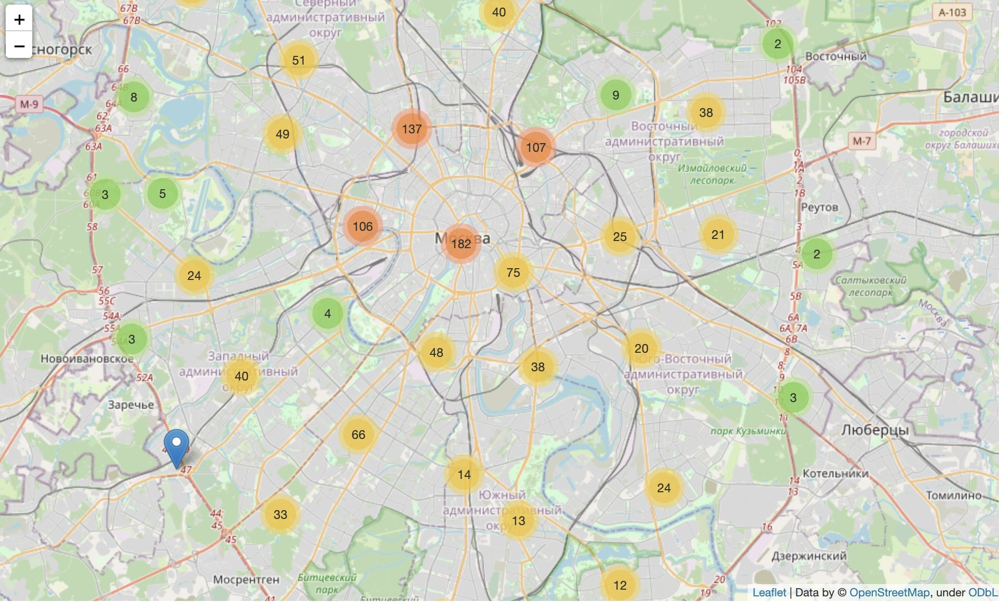

В Москве насчитывается 1411 кофеен. 428 из них расположены в пределах __ЦАО__. Логично предположить, что кофейни пользуются популярностью в местах с наибольшим скоплением людей, нуждающимися в эффекте кофейного напитка или заведении с уютной атмфосферой, где можно провести встречу. 

### Сети и круглосуточные кофейни

In [66]:
coffee247 = (coffee
                   .groupby(['chain','is_24/7'], as_index=False)
                   .agg({'name': 'count'})
                   .sort_values(by = 'name', ascending = False)
                   .reset_index(drop=True)
             )

coffee247.columns = ['Сетевая кофейня', 'Круглосуточное', 'Количество кофеен']

coffee247.loc[(coffee247['Сетевая кофейня'] == 0),'Сетевая кофейня'] = 'Несетевая'
coffee247.loc[(coffee247['Сетевая кофейня'] == 1),'Сетевая кофейня'] = 'Сетевая'

coffee247.loc[(coffee247['Круглосуточное'] == False),'Круглосуточное'] = 'Не круглосуточное'
coffee247.loc[(coffee247['Круглосуточное'] == True),'Круглосуточное'] = 'Круглосуточное'

coffee247.sort_values(by = 'Сетевая кофейня').reset_index(drop = True)

,Сетевая кофейня,Круглосуточное,Количество кофеен
0,Несетевая,Не круглосуточное,665
1,Несетевая,Круглосуточное,8
2,Сетевая,Не круглосуточное,633
3,Сетевая,Круглосуточное,67


In [67]:
fig = px.bar(
             coffee247.sort_values(by='Круглосуточное', ascending = False), 
             x='Количество кофеен',                                     
             y='Сетевая кофейня',                                                
             text='Количество кофеен',
             color='Круглосуточное',
             color_discrete_sequence=px.colors.sequential.RdBu,
             template="plotly_dark"
            )

fig.update_layout(title='Распределение кофеен по пренадлежности к франшизе и режиму работы',
                  xaxis_title='Количество кофеен',
                  yaxis_title='')

fig.show()

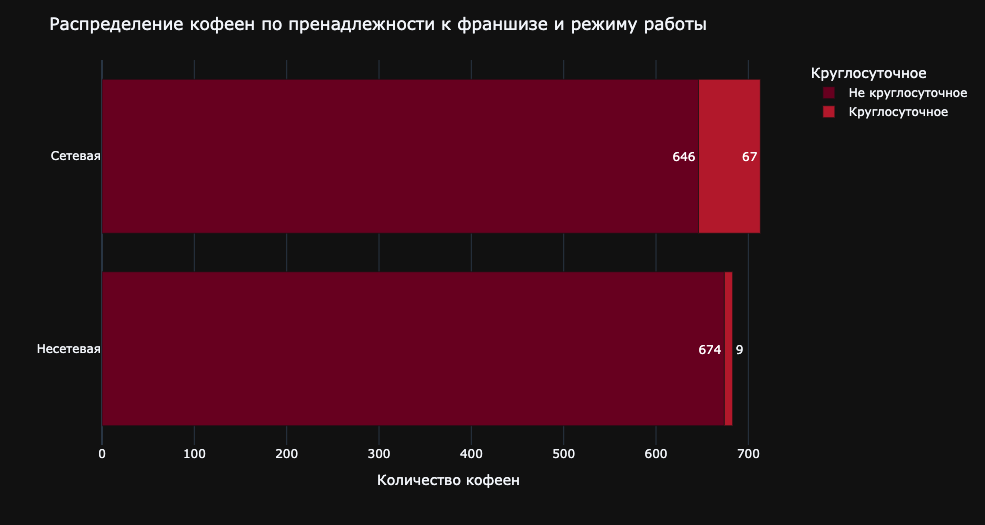

Кофейни в Москве различаются по режиму работы. Среди них также есть и круглосуточные. Всего заведений, готовых работать и поздней ночью в Москве 76. При этом __сетевых круглосуточных кофеен в 7 раз больше__.

### Рейтинги кофеен по районам

In [68]:
coffee_ratings = (data
                      .groupby(['district'], as_index=False)
                      .agg({'rating': 'mean'})
                      .reset_index(drop=True)
                  )

coffee_ratings.columns = ['Административный округ', 'Средний рейтинг']
coffee_ratings['Средний рейтинг'] = round((coffee_ratings['Средний рейтинг']),2)

fig = px.bar(
             coffee_ratings.sort_values(by='Средний рейтинг', ascending = True), 
             x='Средний рейтинг',                                     
             y='Административный округ',                                                
             text='Средний рейтинг',
             color='Средний рейтинг',
             color_continuous_scale='YlGn',
             template="plotly_dark"
            )

fig.update_layout(title='Рейтинг кофеен по районам',
                  xaxis_title='Средний рейтинг',
                  yaxis_title='',
                  xaxis_range=[4,4.3])

fig.show()

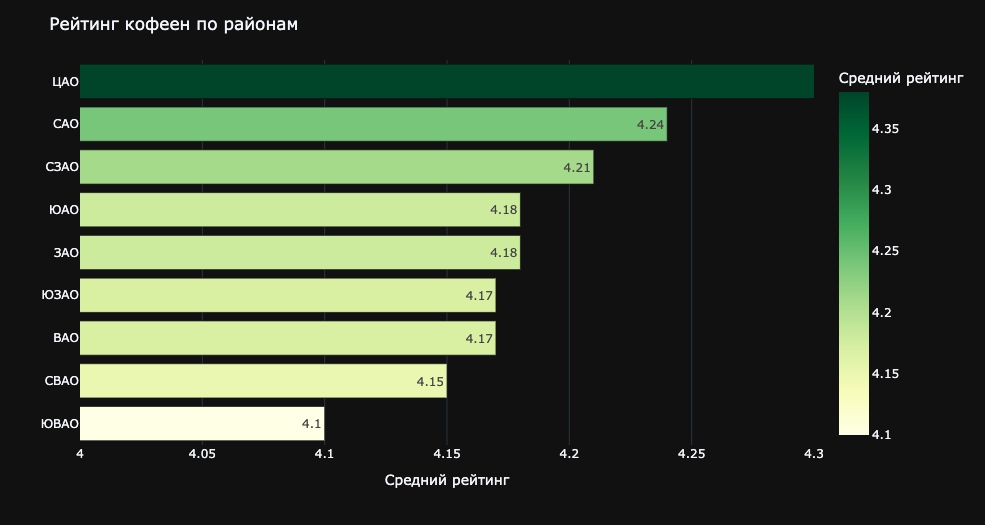

Средний рейтинг кофеен в __ЦАО__ заметно выше, чем у заведений в других округах. Можно предположить, что в центре города посещаемость кофеен выше, и у бариста есть шанс отточить мастерство большим количеством практики. А благодарные посетители оставляют больших хороших отзывов на Яндекс Картах.

### Cтоимость чашки капучино по районам

In [69]:
coffee_cup = coffee.query('middle_coffee_cup >= 0').reset_index(drop=True)

coffee_cup = (coffee_cup
                        .groupby(['district'], as_index=False)
                        .agg({'middle_coffee_cup': 'mean'})
                        .sort_values(by='middle_coffee_cup', ascending = False)
                        .reset_index(drop=True)
              )

coffee_cup.columns = ['Административный округ', 'Средняя цена чашки капучино']
coffee_cup['Средняя цена чашки капучино'] = coffee_cup['Средняя цена чашки капучино'].astype(int)

fig = px.bar(
             coffee_cup.sort_values(by='Средняя цена чашки капучино', ascending = True), 
             x='Средняя цена чашки капучино',                                     
             y='Административный округ',                                                
             text='Средняя цена чашки капучино',
             color='Средняя цена чашки капучино',
             color_continuous_scale='YlOrBr',
             template="plotly_dark"
            )

fig.update_layout(title='Цена чашки капучино по районам',
                  xaxis_title='Средняя цена чашки капучино',
                  yaxis_title='',
                  xaxis_range=[100,200])

fig.show()

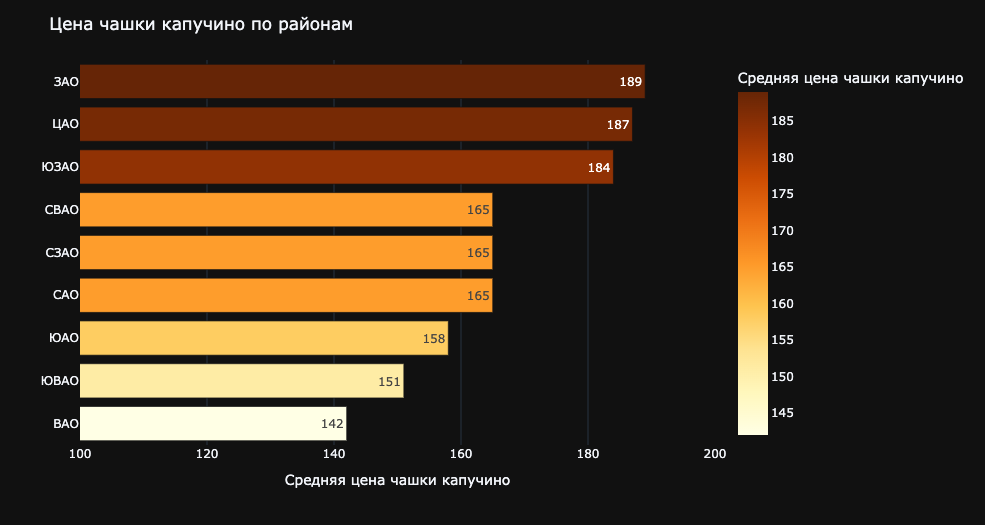

In [70]:
coffee_cup.loc[(coffee_cup['Административный округ'] == 'САО'),'Административный округ'] = 'Северный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'СВАО'),'Административный округ'] = 'Северо-Восточный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'СЗАО'),'Административный округ'] = 'Северо-Западный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'ЗАО'),'Административный округ'] = 'Западный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'ЦАО'),'Административный округ'] = 'Центральный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'ВАО'),'Административный округ'] = 'Восточный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'ЮВАО'),'Административный округ'] = 'Юго-Восточный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'ЮАО'),'Административный округ'] = 'Южный административный округ'
coffee_cup.loc[(coffee_cup['Административный округ'] == 'ЮЗАО'),'Административный округ'] = 'Юго-Западный административный округ'

In [71]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
            geo_data=state_geo,
            data=coffee_cup,
            columns=['Административный округ', 'Средняя цена чашки капучино'],
            key_on='feature.name',
            fill_color='YlOrBr',
            fill_opacity=0.6,
            legend_name='Средняя цена чашки капучино',
           ).add_to(m)

m

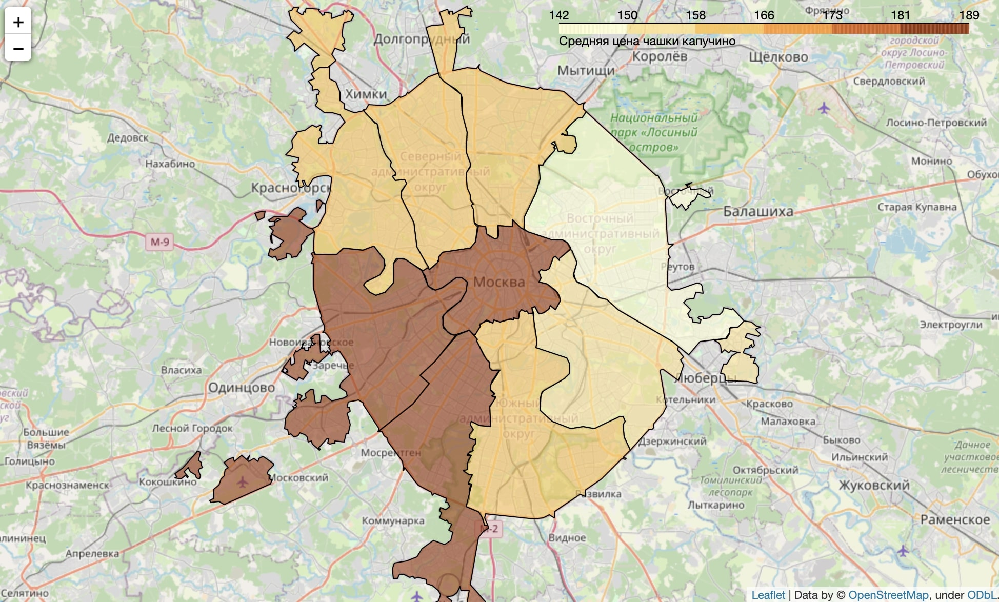

Средняя цена чашки капучино в кофейнях Москвы колеблется от 142 до 189 руб в зависимости от района. Самые высокие в __ЗАО__ и __ЦАО__, самые низкие - в __ВАО__.

In [72]:
coffee_cup = coffee.query('middle_coffee_cup >= 0').reset_index(drop=True)

coffee_cup = (coffee_cup
                        .groupby(['district'], as_index=False)
                        .agg({'middle_coffee_cup': 'mean'})
                        .sort_values(by='middle_coffee_cup', ascending = False)
                        .reset_index(drop=True)
              )

coffee_cup.columns = ['Административный округ', 'Средняя цена чашки капучино']
coffee_cup['Средняя цена чашки капучино'] = coffee_cup['Средняя цена чашки капучино'].astype(int)

coffee_cup = pd.merge(coffee_cup, coffee_ratings, how ='inner', on ='Административный округ')

coffee_cup

,Административный округ,Средняя цена чашки капучино,Средний рейтинг
0,ЗАО,189,4.18
1,ЦАО,187,4.38
2,ЮЗАО,184,4.17
3,САО,165,4.24
4,СЗАО,165,4.21
5,СВАО,165,4.15
6,ЮАО,158,4.18
7,ЮВАО,151,4.10
8,ВАО,142,4.18


In [73]:
fig = px.bar(
             coffee_cup.sort_values(by='Средняя цена чашки капучино', ascending = True), 
             x='Средняя цена чашки капучино',                                     
             y='Административный округ',                                                
             text='Средняя цена чашки капучино',
             color='Средний рейтинг',
             color_continuous_scale='YlGn',
             template="plotly_dark"
            )

fig.update_layout(title='Цена чашки капучино по районам с учётом рейтинга',
                  xaxis_title='Средняя цена чашки капучино',
                  yaxis_title='',
                  xaxis_range=[100,200])

fig.show()

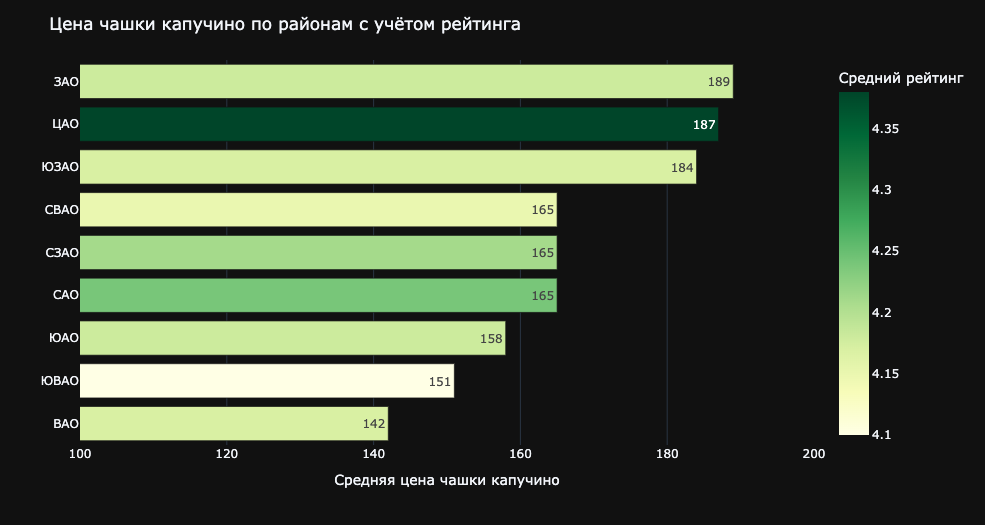

Возможно, есть связь между высокими оценками и ценами на кофе. В кофейнях района __СЗАО__ цена чашки капучино в среднем ниже на 30 руб, а средние оценки выше, чем в __ЦАО__. При этом в __СВАО__ и __САО__ цены такие же, но рейтинг заметно ниже.

По всей видимости, не только ценовая политика определяет успешность кофейни, но и многие другие факторы, которых нет в анализируемом наборе данных.

### Cтоимость чашки капучино по кофейням и в Топ-5 кофеных сетях

Средняя цена на чашку кофе по районам варьируется в достаточно узком диапазоне от 142 до 189. Рассмотрим ценовой диапазон без привязки к административному району или усреднению цены.

In [74]:
coffee_cup = coffee.query('middle_coffee_cup >= 0').reset_index(drop=True)

fig = px.scatter(coffee_cup.sort_values(by='middle_coffee_cup', ascending = True).reset_index(drop=True), 
                 y='middle_coffee_cup',
                 color_discrete_sequence=px.colors.sequential.YlOrBr,
                 template="plotly_dark")

fig.update_layout(title='Цена чашки капучино в кофейнях',
                  xaxis_title='Номер кофейни в ценовом рейтинге',
                  yaxis_title='Цена чашки капучино')

fig.show()

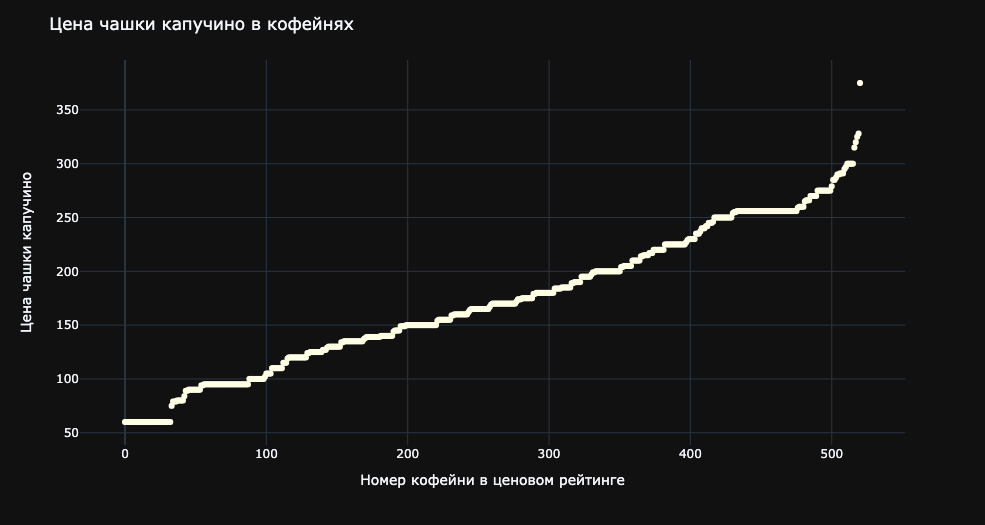

Из визуализации необработанных данных видно, что цена средняя цена капучино в разных кофейнях начинается с 60 и доходит до 375. Также можно видеть "полки" на отметках __60__, __95__ и __256__ руб. Длины этих "полок" показывают сколько кофеен придерживаются одинаковой ценовой политики на капучино. 

Рассмотрим то же распределение, но взяв только кофейни из 5 самых крупных сетевых кофеен.

In [75]:
chains = data.query('chain == 1')

coffe_chains_by_name = (chains.query('category == "кофейня"')
                              .groupby(['name'], as_index=False)
                              .agg({'address': 'count'})
                              .sort_values(by='address', ascending=False)
                              .reset_index(drop=True)
                        ).head(5)

coffe_chains_by_name.columns = ['Название сети заведений', 'Количество заведений в сети']

most_popular_coffee = coffe_chains_by_name['Название сети заведений'].tolist()

coffee_cup = coffee.query('middle_coffee_cup >= 0 & name in @most_popular_coffee').reset_index(drop=True)

coffee_cup = coffee_cup.rename(columns={'name': 'Название сети кофеен'})

fig = px.scatter(coffee_cup.sort_values(by='middle_coffee_cup', ascending = True).reset_index(drop=True), 
                 y='middle_coffee_cup',
                 color='Название сети кофеен',
                 color_discrete_sequence=px.colors.sequential.RdBu,
                 template="plotly_dark")

fig.update_layout(title='Цена чашки капучино в Топ-5 кофейных сетях города',
                  xaxis_title='Номер кофейни в ценовом рейтинге',
                  yaxis_title='Цена чашки капучино')

fig.show()

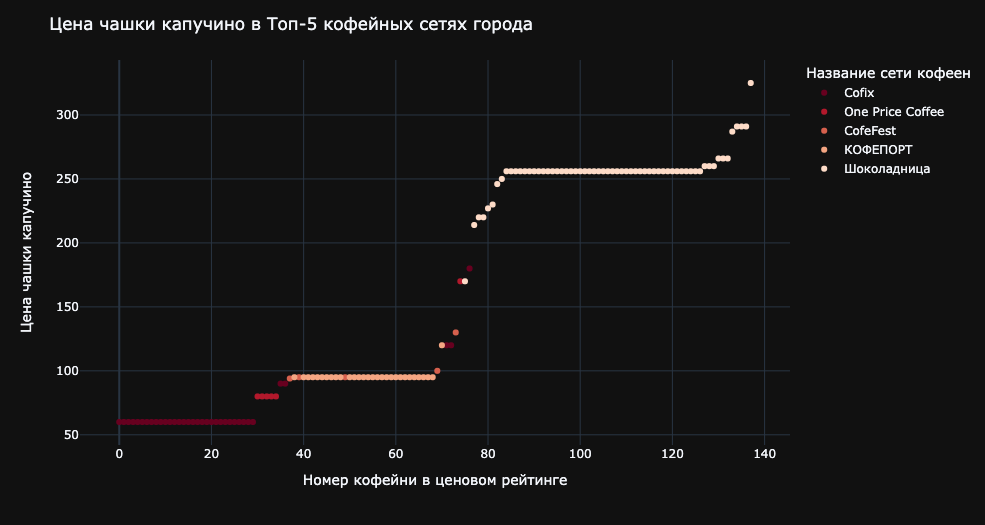

Нужно обратить внимание, что не для всех кофеен из Топ-5 самых популярных сетей указана средняя цена чашки капучино, поэтому на графике количество точек меньше, чем реальное число кофеен в сети. Но ценовая политика для этих сетей очевидна и по усечённым данным.

Ценовая политика во многом зависит не только от качества кофеных зёрен, но и от формата кофейни. 
* В случае сети __Cofix__ цена в 60 руб за чашку обусловлена моделью маленьких кофеен (иногда без посадочных мест) в местах с большой проходимостью, специализирующихся на приготовлении напитков и навынос с небольшим ассортиментом готовых закусок.
* Сеть __КОФЕПОРТ__ предлагает капучино по 95 руб за чашку и представляет собой уютные заведения с посадочными местами и большим выбором готовых десертов.
* __Шоколадница__ - самая большая сеть кофеен Москвы с самой высокой средней ценой за капучино - 256 руб. Кофейни этой сети большие по площади, больше похожи на кафе или рестораны с удобными диванами и собственной кухней.

По всей видимости, при открытие новой кофейни в 2023 году нужно ориентироваться на успешные кофейные сети и их ценовую политику в зависимости от формата задуманного нового заведения.

### Рекомендации для открытия нового заведения

К сожалению, ответить чётко на вопрос инвесторов фонда «Shut Up and Take My Money» "... осуществима ли мечта открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве" невозможно, поскольку задание не сформулировано чётко. 

Не совсем понятно, чего именно хотят инвесторы от нового заведения. Из формулировки задания можно предположить, что  заказчикам не интересен коммерческий успех новой кофейни: "заказчики отметили, что не боятся конкуренции в этой сфере...".  Также не совсем понятно, как определить "крутость и доступность" нового заведения.

Также стоит отметить, что полноценный анализ потенциала открытия нового заведения невозможен без данных как минимум о:

* доступности аренды помещений;
* закупочной стоимости обжаренных кофейных зёрен различного класса (от 50/50 робуста/арабика до спешалти);
* закупочной стоимости оборудования и посуды;
* __объёмов инвестиций__ и заинтересованность инвесторов в окупаемости за конкретный срок.

чего нет ни в формулировки задачи, ни в предоставленном для анализа наборе данных.

Инвесторам также стоит иметь в виду, что не только им нравится сериал «Друзья». Идея создать заведение по мотивам любимого сериала уже пришла в голову группе энтузиастов. Кафе "Френдс" открылось в Москве несколько лет назад, стало успешным и открыло ещё два заведения в Москве и одно в Санкт-Петербурге. 

https://friendsmsk.ru

* __ул. Покровка, 20/1с1  / Рейтинг 4,6 /__

https://yandex.ru/maps/org/frends_v_gostyakh_u_moniki/209720665615/?ll=37.647523%2C55.756124&z=15.0
        
* __ул. Покровка, 31, стр. 1 / Рейтинг 4,2 /__

https://yandex.ru/maps/org/frends_dzho/52043882280/?ll=37.649429%2C55.760534&z=15.0
        
* __Краснобогатырская ул., 90, стр. 2 / Рейтинг 4,5 /__

https://yandex.ru/maps/org/frends/174300601521/?indoorLevel=1&ll=37.710063%2C55.800428&z=15.0

Обстановка заведений соответствует декорациям в оригинальном сериале: фиолетовые стены (квартира Моники), стол для фусбола и кресла - реклайнеры (квартира Джо и Чендлера), большие диваны, стилизованное меню и «Друзья» по телевизору. Высокие, по-сравнению со средними для кофеен, рейтинги кафе "Френдс" могут говорить о популярности заведений, а открывающиеся новые точки - о коммерческой успешности.

Одной из рекомендаций для инвесторов будет рассмотреть возможность __покупки сети кафе "Френдс"__ по мотивам так полюбившегося им сериала.

Для рассмотрения же потенциала открытия нового заведения в настоящий момент не хватает анализируемых данных.